In [48]:
# import libaries
import cv2
import numpy as np
import pandas as pd
import tensorflow as tf
import tensorflow_datasets as tfds
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Model
from tensorflow.keras.layers import (
    Input, Conv2D, MaxPooling2D, UpSampling2D, concatenate, Conv2DTranspose
)
from tensorflow.keras.callbacks import LearningRateScheduler, EarlyStopping
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils.class_weight import compute_class_weight
from skimage import exposure
import matplotlib.pyplot as plt
from pkg_resources import parse_version
from IPython.display import HTML
from matplotlib.animation import FuncAnimation
from flow_util import *  # Import your custom module
import matplotlib.patches as patches
from tensorflow.keras.layers import Concatenate
from tensorflow.keras.layers import Dropout
# Set up matplotlib for interactive plotting in Jupyter Notebooks
%matplotlib inline

# Ensure minimum Python version
import sys
assert sys.version_info >= (3, 5)
import os
import flow_vis
import pandas as pd

## Setup

 First, we mount Google Drive to access and upload data for usage in the Colab environment.

In [49]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [50]:
# to make this notebook's output stable across runs
def reset_seed(seed=42):
    np.random.seed(seed)

# To plot pretty figures - source Aurelien Geron
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12

# Where to save the figures
# Based on post by GM at https://stackoverflow.com/questions/53581278
if 'google.colab' in str(get_ipython()):
  print('Running on CoLab')
  from google.colab import drive
  # mount your google drive into colab
  # this is interactive unfortunately
  # must paste authorization code on prompt
  drive.mount('/content/drive')
  PROJECT_ROOT_DIR = "drive/MyDrive/Colab Notebooks"
else:
  print('Not running on CoLab')
  PROJECT_ROOT_DIR = os.getcwd()

NB_ID = "project"

# create the directory if it does not exist
IMAGE_DIR = os.path.join(PROJECT_ROOT_DIR, "images", NB_ID)
os.makedirs(IMAGE_DIR, exist_ok = True)

def save_fig_nb(fig_id, tight_layout=True):
    path = os.path.join(IMAGE_DIR, fig_id + ".png")
    print("Saving figure", fig_id)
    if tight_layout:
        plt.tight_layout()
    plt.savefig(path, format='png', dpi=300)

os.makedirs(os.path.join(PROJECT_ROOT_DIR,"tb_logs",NB_ID), exist_ok = True)

def get_logdir(add=''):
    import time
    log_id = time.strftime("log_%Y_%m_%d-%H_%M_%S")
    return os.path.join(PROJECT_ROOT_DIR,"tb_logs",NB_ID,log_id+add)

Running on CoLab
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


A couple utility functions to plot grayscale and RGB images (source Aurelien Geron):

In [51]:
def plot_image(image):
    plt.imshow(image, cmap="gray", interpolation="nearest")
    plt.axis("off")

def plot_color_image(image):
    plt.imshow(image.astype(np.uint8),interpolation="nearest")
    plt.axis("off")

In [52]:
# For some reason we seem to need to load tf onto the GPU first
dummy = tf.constant( 32 )
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))

Num GPUs Available:  1


## Data Loading

The dataset is packaged as a Tensorflow dataset in three sub categories.


Prepares and organizes video frame data from three different datasets

In [53]:
# Load the datasets
linear_data_set = tfds.load('linear_movement_rotate', data_dir="/content/drive/MyDrive/Colab Notebooks/tensorflow_data/elg7186_projectdata")
rotate_data_set = tfds.load('rotation_rotate', data_dir="/content/drive/MyDrive/Colab Notebooks/tensorflow_data/elg7186_projectdata")
fixed_data_set = tfds.load('fixed_random_rotate', data_dir="/content/drive/MyDrive/Colab Notebooks/tensorflow_data/elg7186_projectdata")

# Set up iterators over the data
linear_data = iter(linear_data_set['train'])
rotate_data = iter(rotate_data_set['train'])
fixed_data = iter(fixed_data_set['train'])

# Define lists to store frames for each dataset
linear_frames_list = []
rotate_frames_list = []
fixed_frames_list = []

# Loop through all videos in the datasets
for linear_video, rotate_video, fixed_video in zip(linear_data, rotate_data, fixed_data):
    # Append frames to the respective lists
    linear_frames_list.append(linear_video['video'].numpy())
    rotate_frames_list.append(rotate_video['video'].numpy())
    fixed_frames_list.append(fixed_video['video'].numpy())

# Convert lists to NumPy arrays
linear_frames = np.concatenate(linear_frames_list)
rotate_frames = np.concatenate(rotate_frames_list)
fixed_frames = np.concatenate(fixed_frames_list)

# Display the shapes of the resulting arrays
print("Linear Frames Shape:", linear_frames.shape)
print("Rotate Frames Shape:", rotate_frames.shape)
print("Fixed Frames Shape:", fixed_frames.shape)


Linear Frames Shape: (720, 256, 256, 3)
Rotate Frames Shape: (720, 256, 256, 3)
Fixed Frames Shape: (720, 256, 256, 3)


 Processes video frame data from three datasets ('fixed', 'linear', and 'rotating') for analysis. It collects frames, handles varying frame counts, and creates a DataFrame. The DataFrame includes frames organized by video and frame indices. Additionally, the code calculates and prints the total number of frames. Lastly, it generates labeled lists for frames and their corresponding dataset labels.

In [54]:
# Define dataset labels
dataset_labels = ['fixed', 'linear', 'rotating']

# Initialize an empty list to store video frames for all videos
all_video_frames_list = []

# Loop through the linear data dataset and collect video frames
for train_data in linear_data_set['train']:
    video_frames = train_data['video'].numpy()
    all_video_frames_list.append(video_frames)

# Loop through the rotation data dataset and collect video frames
for train_data in rotate_data_set['train']:
    video_frames = train_data['video'].numpy()
    all_video_frames_list.append(video_frames)

# Loop through the fixed data dataset and collect video frames
for train_data in fixed_data_set['train']:
    video_frames = train_data['video'].numpy()
    all_video_frames_list.append(video_frames)

# Now, all_video_frames_list contains the frames of all videos from all three datasets

# Find the video with the maximum number of frames
max_num_frames = max(len(frames) for frames in all_video_frames_list)

# Create an empty list to store data for the DataFrame
data = []

# Loop through each frame and video to create a DataFrame
for frame_idx in range(max_num_frames):
    frame_data = {}
    for video_idx, video_frames in enumerate(all_video_frames_list):
        if frame_idx < len(video_frames):
            frame_data[f'Video_{video_idx + 1}_Frame_{frame_idx + 1}'] = video_frames[frame_idx]
        else:
            frame_data[f'Video_{video_idx + 1}_Frame_{frame_idx + 1}'] = np.nan

    data.append(frame_data)

# Create a DataFrame
video_dataframe = pd.DataFrame(data)
total_frame_counts = video_dataframe.count().sum()
print(f"Total number of frames across all videos: {total_frame_counts}")

my_list1 = []
my_labels1 = []

# Iterate through all frames across all videos
for frame_idx in range(max_num_frames):
    for video_idx, video_frames in enumerate(all_video_frames_list):
        if frame_idx < len(video_frames):
            my_list1.append(np.array(video_frames[frame_idx]))
            my_labels1.append(dataset_labels[video_idx % len(dataset_labels)])

# Now, my_list1 contains all frames across all videos, and my_labels1 contains corresponding labels


Total number of frames across all videos: 2160


# Explor the Data

Let's look at the data_records themselves.

In [55]:
tfds.disable_progress_bar()

print(PROJECT_ROOT_DIR)

data_path = os.path.join(PROJECT_ROOT_DIR, 'tensorflow_data')
os.makedirs(data_path, exist_ok = True)

print("Using directory: ", data_path)

linear_data_set = tfds.load('elg7186_projectdata/linear_movement_rotate',data_dir=data_path)
rotate_data_set = tfds.load('elg7186_projectdata/rotation_rotate',data_dir=data_path)
fixed_data_set = tfds.load('elg7186_projectdata/fixed_random_rotate', data_dir=data_path)

# Set up an iterator over the data
linear_data = iter(linear_data_set['train'])
rotate_data = iter(rotate_data_set['train'])
fixed_data = iter(fixed_data_set['train'])
# Get the first video
train_data_linear = next(linear_data)
train_data_rotation = next(rotate_data)
train_data_fixed = next(fixed_data)

drive/MyDrive/Colab Notebooks
Using directory:  drive/MyDrive/Colab Notebooks/tensorflow_data


Data has format: <class 'dict'>
dict_keys(['background', 'backward_flow', 'camera', 'depth', 'events', 'forward_flow', 'instances', 'metadata', 'normal', 'object_coordinates', 'segmentations', 'video'])
dict_keys(['backward_flow_range', 'depth_range', 'forward_flow_range', 'height', 'num_frames', 'num_instances', 'video_name', 'video_type', 'width'])
dict_keys(['angular_velocities', 'asset_id', 'bbox_frames', 'bboxes', 'bboxes_3d', 'category', 'friction', 'image_positions', 'mass', 'positions', 'quaternions', 'restitution', 'scale', 'velocities', 'visibility'])
tf.Tensor([16 13  6  6 16  6 13], shape=(7,), dtype=int64)
(24, 256, 256, 1)
tf.Tensor(
[b'VEGETABLE_GARDEN' b'Markings_Desk_Caddy'
 b'Diet_Pepsi_Soda_Cola12_Pack_12_oz_Cans'
 b'Pepsi_Max_Cola_Zero_Calorie_12_12_fl_oz_355_ml_cans_144_fl_oz_426_lt'
 b'PINEAPPLE_MARACA_6_PCSSET'
 b'Perricone_MD_Neuropeptide_Firming_Moisturizer'
 b'Remington_1_12_inch_Hair_Straightener'], shape=(7,), dtype=string)
0
7


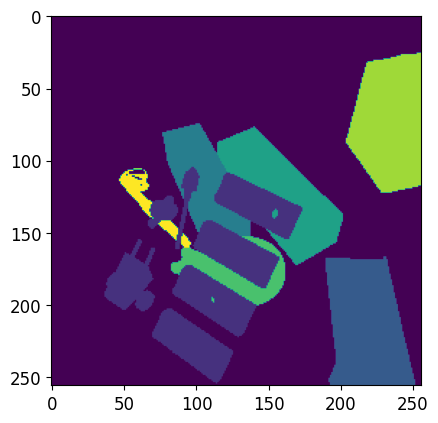

In [56]:
# the type is a subclass of tf.data.Dataset
print('Data has format: {0}'.format(type(train_data_linear)))
# Result is one training movie with the following
print(dict.keys(train_data_linear))
print(dict.keys(train_data_linear['metadata']))
print(dict.keys(train_data_linear['instances']))
print(train_data_linear['instances']['category'])
print(train_data_linear['segmentations'].shape)
print(train_data_linear['instances']['asset_id'])
seg = train_data_linear['segmentations'][0,:,:,:].numpy()
print( np.min(seg) )
print( np.max(seg) )
plt.imshow(train_data_linear['segmentations'][0, :, :, :])

From dict_keys we will use segmentations

**Let's look at segmentation Map as an example**

Provides insights into the structure of the video data, displays frames and corresponding segmentations in a subplot grid, and saves the visualization

train_data_linear

Video:  0001
Video type:  linear_movement_rotate_007
forward_flow range -15.906938552856445 to 20.73499870300293
resolution: [<tf.Tensor: shape=(), dtype=int32, numpy=256>, <tf.Tensor: shape=(), dtype=int32, numpy=256>]
Saving figure 0001_seg


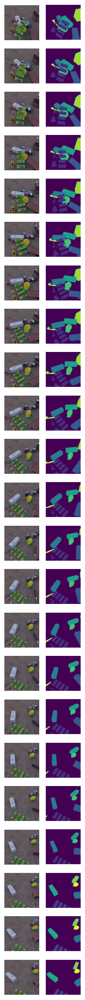

In [57]:
video_name, video_type = get_video_names( train_data_linear['metadata'] )
f_scale, f_offset = get_scale_offset( train_data_linear['metadata'] )

num_frames = int(train_data_linear['metadata']['num_frames'])
resolution = [train_data_linear['metadata']['height'], train_data_linear['metadata']['width']]

print('resolution:', resolution)
x_mesh = np.empty(1)
y_mesh = np.empty(1)

n_cols = 3
figId = plt.figure(figsize=(n_cols, num_frames))

plt.subplots_adjust(wspace=0, hspace=0)

for i in range(num_frames-1):
    img_cnt = i*n_cols
    _ = plt.subplot(num_frames, n_cols, img_cnt+1)
    plt.imshow(train_data_linear['video'][i, :, :, :])
    plt.axis("off")

    ax2 = plt.subplot(num_frames, n_cols, img_cnt+2)
    segmentation = train_data_linear['segmentations'][i, :, :, :].numpy()
    plt.imshow(segmentation)

    plt.axis("off")
    plt.axis("equal")
    plt.axis("off")


save_video_fig(figId, video_name + '_seg', video_type, IMAGE_DIR)

train_data_rotation

Video:  0005
Video type:  rotation_rotate_007
forward_flow range -19.96083641052246 to 24.201967239379883
resolution: [<tf.Tensor: shape=(), dtype=int32, numpy=256>, <tf.Tensor: shape=(), dtype=int32, numpy=256>]
Saving figure 0005_seg


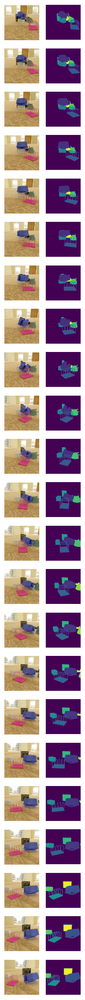

In [58]:
video_name, video_type = get_video_names( train_data_rotation['metadata'] )
f_scale, f_offset = get_scale_offset( train_data_rotation['metadata'] )

num_frames = int(train_data_rotation['metadata']['num_frames'])
resolution = [train_data_rotation['metadata']['height'], train_data_rotation['metadata']['width']]

print('resolution:', resolution)
x_mesh = np.empty(1)
y_mesh = np.empty(1)

n_cols = 3
figId = plt.figure(figsize=(n_cols, num_frames))

plt.subplots_adjust(wspace=0, hspace=0)

for i in range(num_frames-1):
    img_cnt = i*n_cols
    _ = plt.subplot(num_frames, n_cols, img_cnt+1)
    plt.imshow(train_data_rotation['video'][i, :, :, :])
    plt.axis("off")

    ax2 = plt.subplot(num_frames, n_cols, img_cnt+2)
    segmentation = train_data_rotation['segmentations'][i, :, :, :].numpy()
    plt.imshow(segmentation)

    plt.axis("off")
    plt.axis("equal")
    plt.axis("off")


save_video_fig(figId, video_name + '_seg', video_type, IMAGE_DIR)

train_data_fixed

Video:  0003
Video type:  fixed_random_rotate_007
forward_flow range -16.59033203125 to 16.885251998901367
resolution: [<tf.Tensor: shape=(), dtype=int32, numpy=256>, <tf.Tensor: shape=(), dtype=int32, numpy=256>]
Saving figure 0003_seg


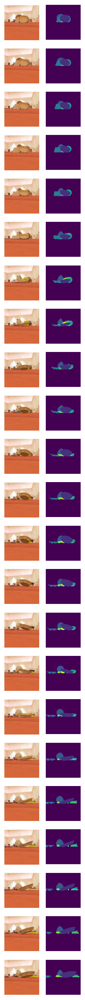

In [59]:
video_name, video_type = get_video_names( train_data_fixed['metadata'] )
f_scale, f_offset = get_scale_offset( train_data_fixed['metadata'] )

num_frames = int(train_data_fixed['metadata']['num_frames'])
resolution = [train_data_fixed['metadata']['height'], train_data_fixed['metadata']['width']]

print('resolution:', resolution)
x_mesh = np.empty(1)
y_mesh = np.empty(1)

n_cols = 3
figId = plt.figure(figsize=(n_cols, num_frames))

plt.subplots_adjust(wspace=0, hspace=0)

for i in range(num_frames-1):
    img_cnt = i*n_cols
    _ = plt.subplot(num_frames, n_cols, img_cnt+1)
    plt.imshow(train_data_fixed['video'][i, :, :, :])
    plt.axis("off")

    ax2 = plt.subplot(num_frames, n_cols, img_cnt+2)
    segmentation = train_data_fixed['segmentations'][i, :, :, :].numpy()
    plt.imshow(segmentation)

    plt.axis("off")
    plt.axis("equal")
    plt.axis("off")


save_video_fig(figId, video_name + '_seg', video_type, IMAGE_DIR)

**Visualization**

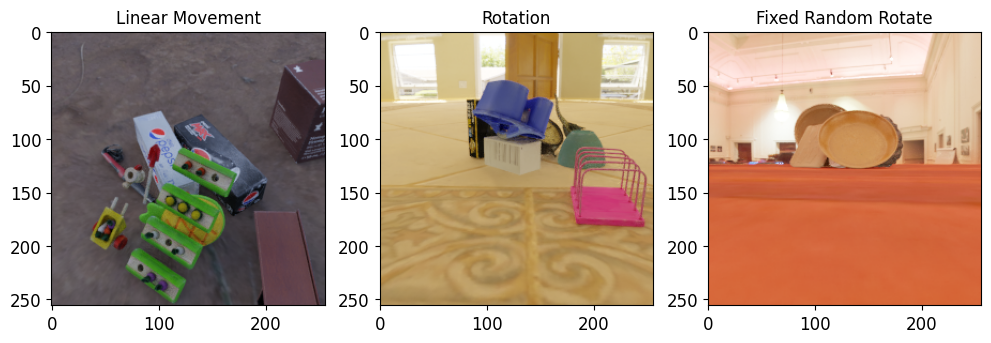

In [60]:
#Visualization
video_data_linear = train_data_linear['video'][0]
video_data_rotation = train_data_rotation['video'][0]
video_data_fixed = train_data_fixed['video'][0]

# Display a frame from each train data
plt.figure(figsize=(12, 4))

plt.subplot(131)
plt.imshow(video_data_linear)
plt.title("Linear Movement")

plt.subplot(132)
plt.imshow(video_data_rotation)
plt.title("Rotation")

plt.subplot(133)
plt.imshow(video_data_fixed)
plt.title("Fixed Random Rotate")

plt.show()


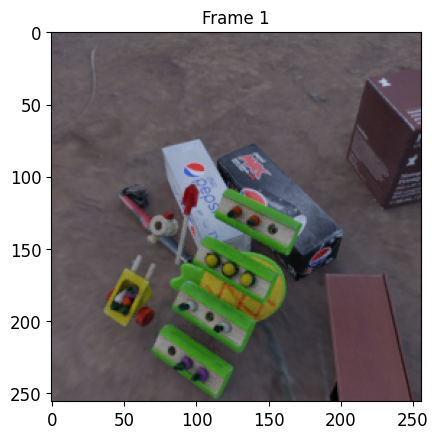

In [61]:
video_frames1 = train_data_linear['video']
# Create a function to update the frames in the animation
def update(frame):
    plt.imshow(video_frames1[frame])
    plt.title(f'Frame {frame + 1}')

# Create a figure and an animation
fig, ax = plt.subplots()
ani1= FuncAnimation(fig, update, frames=len(video_frames1), interval=100)
# Display the animation as a video in the notebook
HTML(ani1.to_jshtml())

# Creating the DataFrame we will use.

In [62]:
# Create a dictionary containing 'Images' and 'labels'
data = {
    'Images': my_list1,
    'labels':my_labels1
}

# Create the DataFrame
df = pd.DataFrame(data)

In [37]:
len(df)

2160

In [38]:
df.head()

,Images,labels
0,"[[[97, 88, 91], [97, 87, 91], [96, 86, 90], [9...",fixed
1,"[[[202, 85, 49], [202, 85, 49], [202, 84, 49],...",linear
2,"[[[102, 94, 99], [100, 92, 97], [102, 94, 99],...",rotating
3,"[[[137, 134, 124], [136, 135, 125], [138, 136,...",fixed
4,"[[[236, 232, 230], [234, 231, 228], [229, 226,...",linear


 Processes video segmentation data from three datasets ('fixed', 'linear', and 'rotating') to create a unified DataFrame. It collects segmentation frames, handles varying frame counts, and creates a DataFrame with columns named based on video indices and segmentation frame indices.

In [39]:
import pandas as pd

# Define dataset labels
dataset_labels = ['fixed', 'linear', 'rotating']

# Initialize an empty list to store video frames for all videos
all_video_segmentations_list = []

# Loop through the linear data dataset and collect video frames
for train_data in linear_data_set['train']:
    video_frames = train_data['segmentations'].numpy()
    all_video_segmentations_list.append(video_frames)

# Loop through the rotation data dataset and collect video frames
for train_data in rotate_data_set['train']:
    video_frames = train_data['segmentations'].numpy()
    all_video_segmentations_list.append(video_frames)

# Loop through the fixed data dataset and collect video frames
for train_data in fixed_data_set['train']:
    video_frames = train_data['segmentations'].numpy()
    all_video_segmentations_list.append(video_frames)

# Now, all_video_segmentations_list contains the frames of all videos from all three datasets

# Find the video with the maximum number of frames
max_num_frames = max(len(frames) for frames in all_video_segmentations_list)

# Create an empty list to store data for the DataFrame
data = []

# Loop through each frame and video to create a DataFrame
for frame_idx in range(max_num_frames):
    frame_data = {}
    for video_idx, video_frames in enumerate(all_video_segmentations_list):
        if frame_idx < len(video_frames):
            frame_data[f'Video_{video_idx + 1}_Segmentations_{frame_idx + 1}'] = video_frames[frame_idx]
        else:
            frame_data[f'Video_{video_idx + 1}_Segmentations_{frame_idx + 1}'] = np.nan

    data.append(frame_data)

# Create a DataFrame
video_dataframe = pd.DataFrame(data)
total_frame_counts = video_dataframe.count().sum()
print(f"Total number of frames across all videos: {total_frame_counts}")

my_list2 = []
my_labels2 = []

# Iterate through all frames across all videos
for frame_idx in range(max_num_frames):
    for video_idx, video_frames in enumerate(all_video_segmentations_list):
        if frame_idx < len(video_frames):
            my_list2.append(np.array(video_frames[frame_idx]))
            my_labels2.append(dataset_labels[video_idx % len(dataset_labels)])  # Corrected line


Total number of frames across all videos: 2160


In [40]:
# Create a dictionary containing 'Images' and 'labels'
data2 = {
    'Segmentations': my_list2,
    #'labels':my_labels2
}

# Create the DataFrame
df2 = pd.DataFrame(data2)

In [41]:
df2.head()

,Segmentations
0,"[[[0], [0], [0], [0], [0], [0], [0], [0], [0],..."
1,"[[[0], [0], [0], [0], [0], [0], [0], [0], [0],..."
2,"[[[0], [0], [0], [0], [0], [0], [0], [0], [0],..."
3,"[[[0], [0], [0], [0], [0], [0], [0], [0], [0],..."
4,"[[[0], [0], [0], [0], [0], [0], [0], [0], [0],..."


In [42]:
len(df2)

2160

In [43]:
# Reset index to use numerical indices
df.reset_index(drop=True, inplace=True)
df2.reset_index(drop=True, inplace=True)

# Concatenate the two DataFrames along columns
merged_df = pd.concat([df, df2], axis=1)

# Print the shape of the merged DataFrame
print(merged_df.shape)


(2160, 3)


In [44]:
merged_df.head()

,Images,labels,Segmentations
0,"[[[97, 88, 91], [97, 87, 91], [96, 86, 90], [9...",fixed,"[[[0], [0], [0], [0], [0], [0], [0], [0], [0],..."
1,"[[[202, 85, 49], [202, 85, 49], [202, 84, 49],...",linear,"[[[0], [0], [0], [0], [0], [0], [0], [0], [0],..."
2,"[[[102, 94, 99], [100, 92, 97], [102, 94, 99],...",rotating,"[[[0], [0], [0], [0], [0], [0], [0], [0], [0],..."
3,"[[[137, 134, 124], [136, 135, 125], [138, 136,...",fixed,"[[[0], [0], [0], [0], [0], [0], [0], [0], [0],..."
4,"[[[236, 232, 230], [234, 231, 228], [229, 226,...",linear,"[[[0], [0], [0], [0], [0], [0], [0], [0], [0],..."


In [45]:
print(merged_df.columns)

Index(['Images', 'labels', 'Segmentations'], dtype='object')


**Our final DataFrame is merged_df, which contains ['Images', 'Labels', 'Segmentations']. We will use them in the segmentation model.**

# Preprocess and prepare a dataset for image segmentation

**Data Preprocessing:**

Applies the defined functions to the DataFrame merged_df.

Resizes images and masks to (256x256) pixels.

Normalizes pixel values in the resized images.

Converts the data to the appropriate format for model input, resulting in NumPy arrays (images and masks).

histogram equalization to enhance image contrast.

Splits the data into training and test sets

In [46]:
from skimage import exposure

# Resize the images and segmentation masks to a uniform size
def resize_images_and_masks(df, size):
    df['Resized_Images'] = df['Images'].apply(lambda img: cv2.resize(img, size))
    df['Resized_Segmentations'] = df['Segmentations'].apply(lambda mask: cv2.resize(mask, size))

# Normalize the pixel values
def normalize_pixels(df):
    df['Resized_Images'] = df['Resized_Images'] / 255.0

# Convert the data to the appropriate format for the model
def convert_data_format(df):
    images = np.array(df['Resized_Images'].tolist())
    masks = np.array(df['Resized_Segmentations'].tolist())

    return images, masks

# Preprocess the data
resize_images_and_masks(merged_df, (256, 256))
normalize_pixels(merged_df)
images, masks = convert_data_format(merged_df)

# Function for additional preprocessing
def preprocess_images(images):
    preprocessed_images = []
    for img in images:
        # histogram equalization can enhance image contrast
        img = exposure.equalize_hist(img)
        preprocessed_images.append(img)

    return np.array(preprocessed_images)

# Preprocess images
preprocessed_images = preprocess_images(images)

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(
    preprocessed_images, masks, test_size=0.2, random_state=42)

# Convert the segmentation masks to one-hot encoding for the training set
y_train_one_hot = tf.keras.utils.to_categorical(y_train, num_classes=8)

# Convert the segmentation masks to one-hot encoding for the test set
y_test_one_hot = tf.keras.utils.to_categorical(y_test, num_classes=8)


/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: This might be a color image. The histogram will be computed on the flattened image. You can instead apply this function to each color channel, or set channel_axis.
  return func(*args, **kwargs)


One-Hot Encoding:

Converts the segmentation masks to one-hot encoding for both the training and test sets (y_train_one_hot and y_test_one_hot) with num_classes=8.


 Prepares image segmentation data by resizing, normalizing, and converting it into the appropriate format for model training. It also includes additional preprocessing steps such as histogram equalization for image enhancement. The data is then split into training and test sets, and segmentation masks are converted to one-hot encoding for model compatibility.

# Model

We chose U-net.

We chose u-net because U-Net is adept at handling objects of different sizes in the image. The skip connections enable the model to combine both global and local contextual information, making it suitable for segmenting objects of varying scales.U-Net follows an encoder-decoder architecture, where the contracting path captures contextual information and the expansive path enables precise localization. This architecture is effective for segmentation tasks, allowing the model to capture both global and local features.U-Net incorporates skip connections that connect the encoder's feature maps to the corresponding decoder's feature maps. These connections help retain fine-grained details during upsampling, addressing the issue of information loss in traditional encoder-decoder structures.U-Net often requires less training data compared to some other architectures. This is beneficial when labeled data for segmentation tasks is limited like our data.U-Net's architecture is well-documented and openly available, making it easy for researchers and practitioners to implement and customize according to our specific needs.

## 1-Semantic Segmentation

The binary nature of Semantic Segmentation outputs (0 or 1) reflects the presence or absence of objects at each pixel. The choice of architecture is U-Net

One-Hot Encoding:

Converts segmentation masks to one-hot encoding for both the training and test sets, considering the binary segmentation task.

U-Net Model Architecture:

Defines a U-Net model specifically tailored for binary segmentation.
The model consists of an encoder-decoder structure with skip connections, effectively capturing both local and global features.
Utilizes convolutional layers with ReLU activation and the sigmoid activation in the output layer for binary segmentation.
Compiles the model using the Adam optimizer and binary crossentropy loss.
Training:

Trains the U-Net model on the training data, 16 epochs, 20 batch size, and validation data.


Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, 256, 256, 64)         1792      ['input_1[0][0]']             
                                                                                                  
 conv2d_1 (Conv2D)           (None, 256, 256, 64)         36928     ['conv2d[0][0]']              
                                                                                                  
 max_pooling2d (MaxPooling2  (None, 128, 128, 64)         0         ['conv2d_1[0][0]']            
 D)                                                                                           

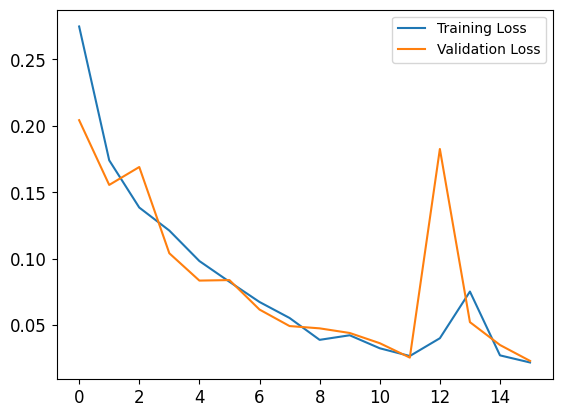

14/14 [==============================] - 18s 740ms/step - loss: 0.0231 - accuracy: 0.9911
Test Loss: 0.0231
Test Accuracy: 0.9911


In [ ]:
import numpy as np
import cv2
from sklearn.model_selection import train_test_split
from skimage import exposure
import tensorflow as tf
from keras.models import Model
from keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, concatenate
from keras.optimizers import Adam
import matplotlib.pyplot as plt

# Resize the images and segmentation masks to a uniform size
def resize_images_and_masks_bi(df, size):
    df['Resized_Images'] = df['Images'].apply(lambda img: cv2.resize(img, size))
    df['Resized_Segmentations'] = df['Segmentations'].apply(lambda mask: cv2.resize(mask, size))

# Normalize the pixel values
def normalize_pixels_bi(df):
    df['Resized_Images'] = df['Resized_Images'] / 255.0

# Convert the data to the appropriate format for the model
def convert_data_format_bi(df, binary=True):
    images = np.array(df['Resized_Images'].tolist())
    masks = np.array(df['Resized_Segmentations'].tolist())

    if binary:
        masks = (masks > 0).astype(int)  # Convert to binary format

    return images, masks

# Preprocess the data
resize_images_and_masks_bi(merged_df, (256, 256))
normalize_pixels_bi(merged_df)
images_bi, masks_bi = convert_data_format_bi(merged_df, binary=True)

# Function for additional preprocessing
def preprocess_images_bi(images):
    preprocessed_images = []
    for img in images:
        # histogram equalization can enhance image contrast
        img = exposure.equalize_hist(img)
        preprocessed_images.append(img)

    return np.array(preprocessed_images)

# Preprocess images
preprocessed_images_bi = preprocess_images_bi(images)

# Split the data into training and test sets
X_train_bi, X_test_bi, y_train_bi, y_test_bi = train_test_split(
    preprocessed_images_bi, masks_bi, test_size=0.2, random_state=42)

# Convert the segmentation masks to one-hot encoding for the training set
y_train_one_hot_bi = tf.keras.utils.to_categorical(y_train_bi, num_classes=2) #binary segmentation

# Convert the segmentation masks to one-hot encoding for the test set
y_test_one_hot_bi = tf.keras.utils.to_categorical(y_test_bi, num_classes=2)  #binary segmentation

# Define the U-Net model for binary segmentation
def unet_model_binary(input_size=(256, 256, 3)):
    inputs = Input(input_size)

    # Encoder
    conv1 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(inputs)
    conv1 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

    conv2 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool1)
    conv2 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)

    conv3 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool2)
    conv3 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)

    # Bottleneck
    conv4 = Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool3)
    conv4 = Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv4)

    # Decoder
    up5 = concatenate([UpSampling2D(size=(2, 2))(conv4), conv3], axis=-1)
    conv5 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(up5)
    conv5 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv5)

    up6 = concatenate([UpSampling2D(size=(2, 2))(conv5), conv2], axis=-1)
    conv6 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(up6)
    conv6 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv6)

    up7 = concatenate([UpSampling2D(size=(2, 2))(conv6), conv1], axis=-1)
    conv7 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(up7)
    conv7 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv7)

    # Output layer
    outputs = Conv2D(1, 1, activation='sigmoid')(conv7)

    model = Model(inputs=inputs, outputs=outputs)

    # Compile the model
    model.compile(optimizer=Adam(learning_rate=0.0001), loss='binary_crossentropy', metrics=['accuracy'])

    return model

# Create the U-Net model for binary segmentation
model_binary = unet_model_binary()

# Print the model summary
model_binary.summary()

# Train the model for binary segmentation
history_binary = model_binary.fit(X_train_bi, y_train_bi, epochs=16, batch_size=20, validation_data=(X_test_bi, y_test_bi))

# Visualize training history
plt.plot(history_binary.history['loss'], label='Training Loss')
plt.plot(history_binary.history['val_loss'], label='Validation Loss')
plt.legend()
plt.show()

# Evaluate the model for binary segmentation
loss_binary, accuracy_binary = model_binary.evaluate(X_test_bi, y_test_bi)
print(f"Test Loss: {loss_binary:.4f}")
print(f"Test Accuracy: {accuracy_binary:.4f}")



Visualization of Training History:

Plots the training and validation loss over epochs for visualizing the model's learning progress.
Model Evaluation:
Evaluates the trained model on the test set which is Test Loss: 0.0231
Test Accuracy: 0.9911

 val_loss: 0.0231 - val_accuracy: 0.9911

Test Loss: 0.0231- Test Accuracy: 0.9911
So we don't have overfitting

**Visualization for images,masks and our model prediction**

1/1 [==============================] - 2s 2s/step


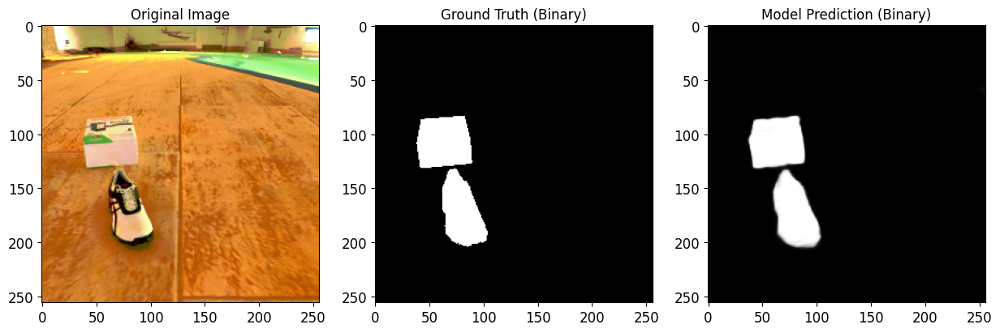

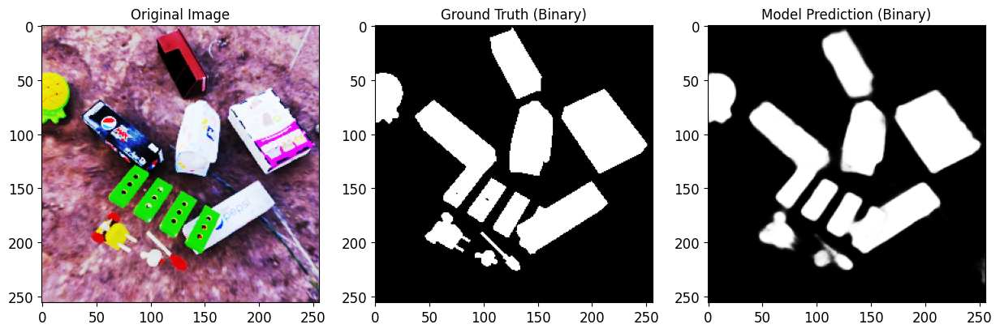

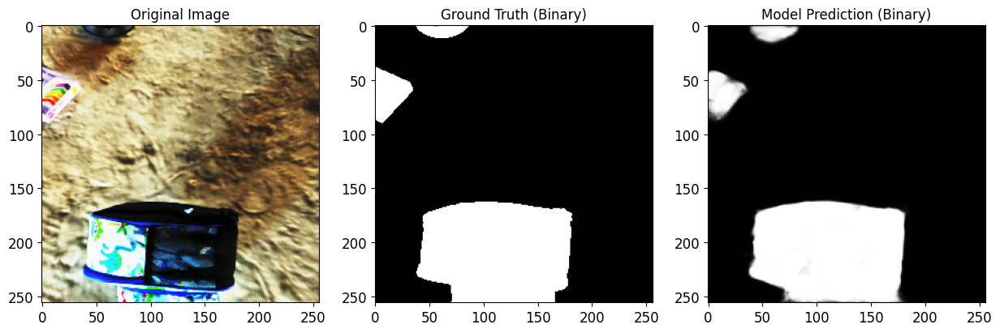

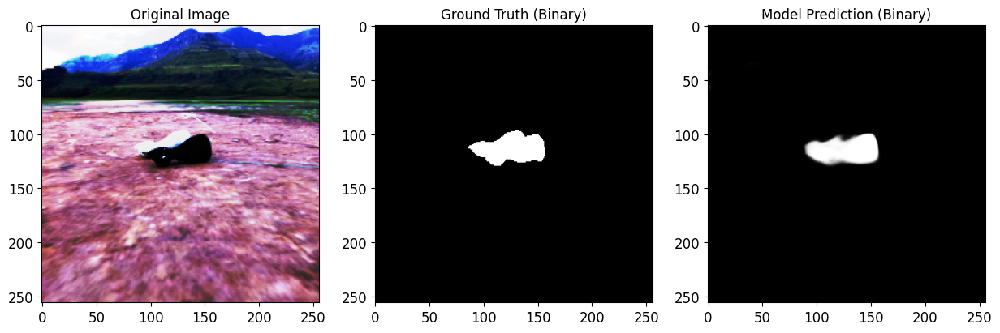

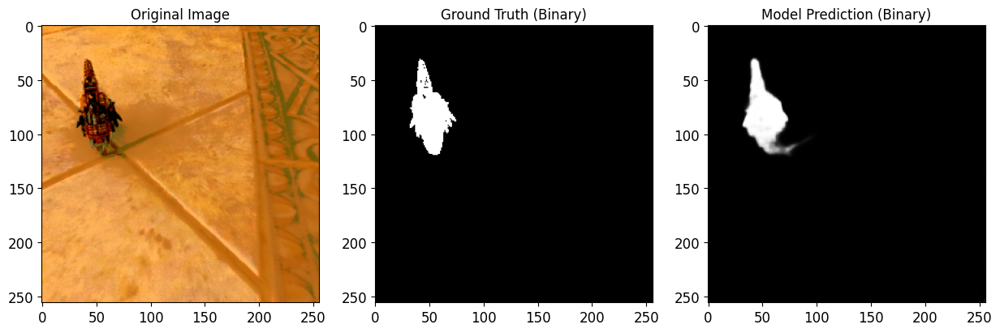

In [ ]:
# Visualize predictions for a few test samples
predictions_binary = model_binary.predict(X_test_bi[:5])

for i in range(5):
    plt.figure(figsize=(15, 5))

    plt.subplot(1, 3, 1)
    plt.imshow(X_test_bi[i])
    plt.title("Original Image")

    plt.subplot(1, 3, 2)
    plt.imshow(y_test_bi[i].squeeze(), cmap='gray')
    plt.title("Ground Truth (Binary)")

    plt.subplot(1, 3, 3)
    plt.imshow(predictions_binary[i].squeeze(), cmap='gray', vmin=0, vmax=1)
    plt.title("Model Prediction (Binary)")

    plt.show()

The model considers all objects as one single entity and cannot distinguish between individual objects due to its semantic segmentation nature.

**Calculates the Dice coefficient for binary segmentation predictions generated by a model**

The Dice coefficient is a metric commonly used for evaluating the similarity between predicted and ground truth binary masks. The mean Dice coefficient provides a consolidated measure of the model's accuracy in segmenting binary objects.

In [ ]:
import numpy as np
import tensorflow as tf
def calculate_dice(y_true, y_pred, smooth=1.0):
    intersection = np.sum(np.abs(y_true * y_pred))
    dice = (2.0 * intersection + smooth) / (np.sum(y_true) + np.sum(y_pred) + smooth)
    return np.clip(dice, 0.0, 1.0)  # Clip values to the valid range [0, 1]


# Predict on test set
y_pred_binary = model_binary.predict(X_test_bi)

# Round predictions to convert to binary values
y_pred_binary = np.round(y_pred_binary)

# Calculate Dice for each sample in the test set
dices = []

for i in range(len(y_test_bi)):
    dice = calculate_dice(y_test_bi[i], y_pred_binary[i])
    dices.append(dice)

mean_dice = np.mean(dices)
print(f"Mean Dice: {mean_dice:.4f}")


14/14 [==============================] - 5s 413ms/step
Mean Dice: 0.9546


The Dice coefficient serves as a quantitative measure of segmentation quality, capturing the degree of agreement between predicted and true binary masks. The mean Dice coefficient offers a consolidated evaluation of the model's performance on the binary segmentation task.
Mean Dice is  0.9546 .
This result shows that our model work well.

**Calculates the Intersection over Union (IoU) metric for binary segmentation**

Emphasizing the mean IoU as a comprehensive evaluation of segmentation quality. The TensorFlow MeanIoU metric streamlines the computation of this metric, offering a standardized and convenient approach for model evaluation.

In [ ]:
def calculate_iou(y_true, y_pred, smooth=1.0):
    intersection = np.sum(np.abs(np.round(y_true) * np.round(y_pred)))
    union = np.sum(np.abs(np.round(y_true) + np.round(y_pred))) - intersection
    iou = (intersection + smooth) / (union + smooth)
    return np.clip(iou, 0.0, 1.0)
# Create a MeanIoU metric
mean_iou = tf.keras.metrics.MeanIoU(num_classes=2)

# Update the metric with the ground truth and predicted masks
mean_iou.update_state(np.round(y_test_bi), np.round(y_pred_binary))

# Get the result
result_iou = mean_iou.result().numpy()

print(f"Mean IoU: {result_iou:.4f}")


Mean IoU: 0.9527


IoU Calculation Function: Defines a function calculate_iou for computing the IoU metric, which quantifies the overlap between predicted and ground truth binary masks. Rounding is applied to convert continuous values to binary masks.
MeanIoU Metric Initialization:

Creates a MeanIoU metric using TensorFlow's MeanIoU class, specifying two classes for binary segmentation.
Update Metric with Ground Truth and Predictions:

Updates the MeanIoU metric state using the rounded ground truth (np.round(y_test_bi)) and predicted binary masks (np.round(y_pred_binary)).
Retrieve and Print the Mean IoU Result:

Retrieves the mean IoU result from the updated MeanIoU metric.
Prints the calculated Mean IoU, providing a consolidated measure of segmentation accuracy that considers both true positive and false positive predictions.

Mean IoU is 0.9527 and it's a high value, so our model work correctly

#2-Instance Segmentation

Identifying and delineating individual objects within an image, providing a pixel-level mask for each object.

Calculate total number of unique classes in the segmentation masks across all frames.

In [ ]:
import numpy as np
all_unique_classes = set()

for masks in merged_df['Segmentations']:
    unique_classes_in_frame = np.unique(masks)
    all_unique_classes.update(unique_classes_in_frame)

num_classes = len(all_unique_classes)
print(f"Number of Classes: {num_classes}")

Number of Classes: 8


So, from previous code we will use 8 classes in instance segmentation

 implements a U-Net architecture for multi-class segmentation and trains it on a dataset. Here's a summary suitable for a report:

U-Net Model Architecture:

Defines a U-Net model for multi-class segmentation with encoder and decoder blocks, incorporating convolutional layers, max-pooling, dropout, and up-sampling layers.
Model Compilation:

Compiles the model using the Adam optimizer with a learning rate of 0.0001 and categorical cross-entropy loss function.
Model Summary:Displays a summary of the U-Net model, providing an overview of the network architecture and the number of parameters.
Training:

Trains the multi-class segmentation model using training data (X_train and y_train_one_hot) for 20 epochs, with a batch size of 8 and a 10% validation split.
Training History:

Collects and stores the training history (history_multi_class) to analyze model performance over epochs.
Evaluation:

Evaluates the trained model on the test set (X_test and y_test_one_hot) to assess its performance.
Test Metrics:
Prints the test loss and accuracy, providing quantitative measures of how well the model generalizes to unseen data.

In [ ]:
# Define the U-Net model for multi-class segmentation
def unet_model(input_size=(256, 256, 3), num_classes=8):
    inputs = Input(input_size)

    # Encoder
    conv1 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(inputs)
    conv1 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

    conv2 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool1)
    conv2 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)

    conv3 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool2)
    conv3 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)

    # Bottleneck
    conv4 = Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool3)
    conv4 = Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv4)
    drop4 = Dropout(0.5)(conv4)
    pool4 = MaxPooling2D(pool_size=(2, 2))(drop4)

    conv5 = Conv2D(1024, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool4)
    conv5 = Conv2D(1024, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv5)
    drop5 = Dropout(0.5)(conv5)

    # Decoder
    up6 = Concatenate()([UpSampling2D(size=(2, 2))(drop5), conv4])
    conv6 = Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(up6)
    conv6 = Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv6)

    up7 = Concatenate()([UpSampling2D(size=(2, 2))(conv6), conv3])
    conv7 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(up7)
    conv7 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv7)

    up8 = Concatenate()([UpSampling2D(size=(2, 2))(conv7), conv2])
    conv8 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(up8)
    conv8 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv8)

    up9 = Concatenate()([UpSampling2D(size=(2, 2))(conv8), conv1])
    conv9 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(up9)
    conv9 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv9)

    # Output layer
    conv10 = Conv2D(num_classes, 1, activation='softmax')(conv9)

    model = Model(inputs=inputs, outputs=conv10)

    model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

    return model

# Create the model
model_multi_class = unet_model()

# Display the model summary
model_multi_class.summary()

# Train the model
history_multi_class = model_multi_class.fit(X_train, y_train_one_hot, validation_split=0.1, epochs=20, batch_size=8)

# Evaluate the multi-class segmentation model
loss_multi_class, accuracy_multi_class = model_multi_class.evaluate(X_test, y_test_one_hot)
print(f"Test Loss: {loss_multi_class:.4f}")
print(f"Test Accuracy: {accuracy_multi_class:.4f}")

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_2 (InputLayer)        [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 conv2d_19 (Conv2D)          (None, 256, 256, 64)         1792      ['input_2[0][0]']             
                                                                                                  
 conv2d_20 (Conv2D)          (None, 256, 256, 64)         36928     ['conv2d_19[0][0]']           
                                                                                                  
 max_pooling2d_4 (MaxPoolin  (None, 128, 128, 64)         0         ['conv2d_20[0][0]']           
 g2D)                                                                                       

Test Loss: 0.0212 - Test Accuracy: 0.9922
and
val_loss: 0.0224 - val_accuracy: 0.9920
,so we don't have overfitting



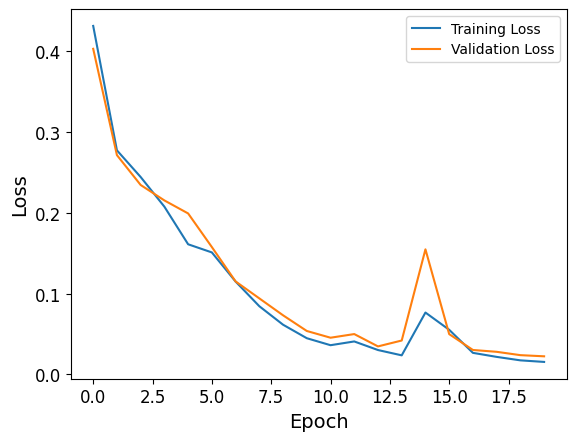

In [ ]:
# Plot the training and validation loss
plt.plot(history_multi_class.history['loss'], label='Training Loss')
plt.plot(history_multi_class.history['val_loss'], label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

 Visualize predictions for a few test samples

1/1 [==============================] - 0s 187ms/step


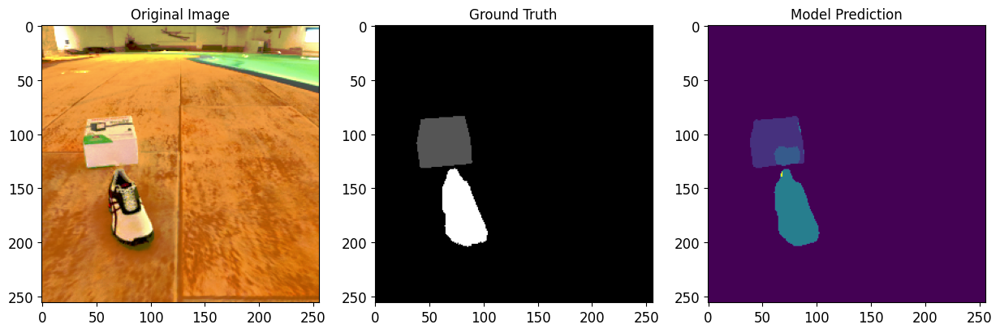

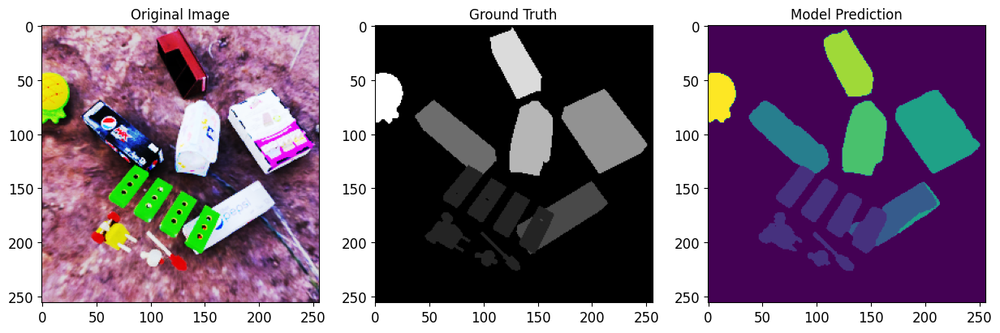

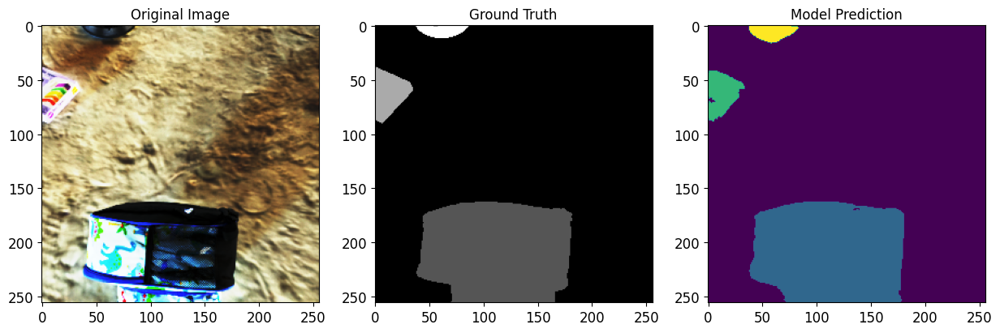

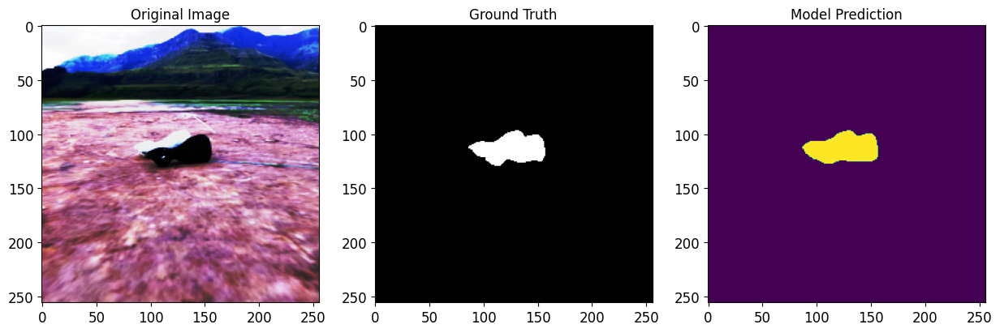

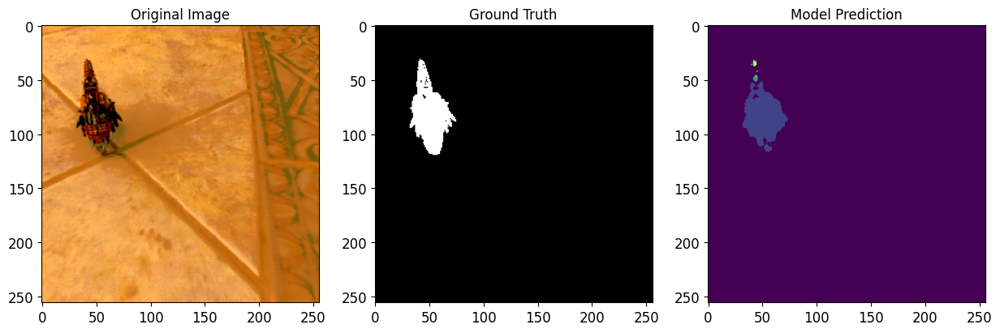

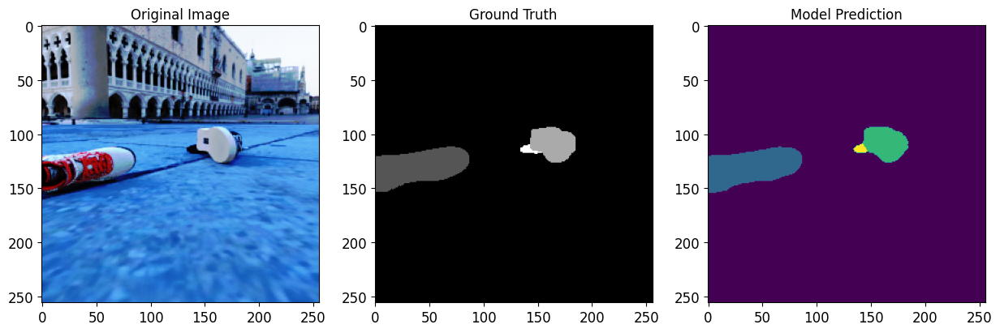

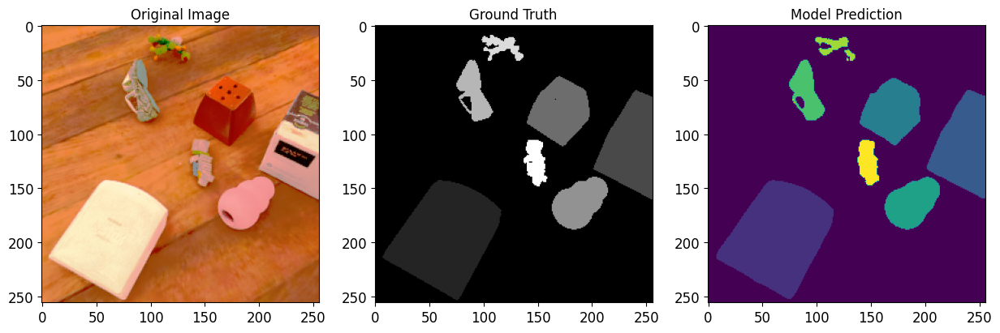

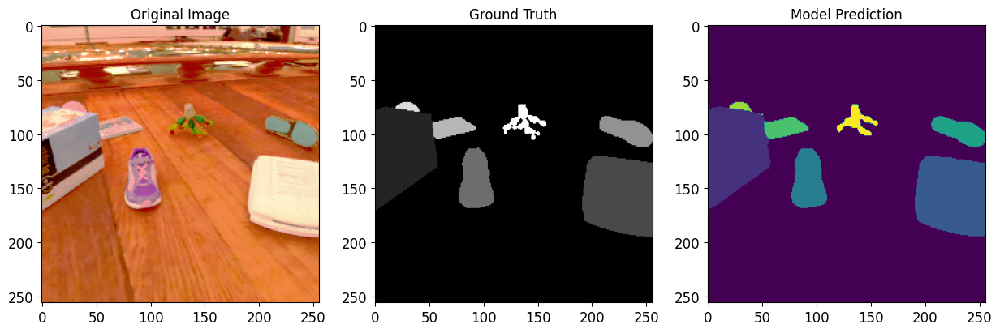

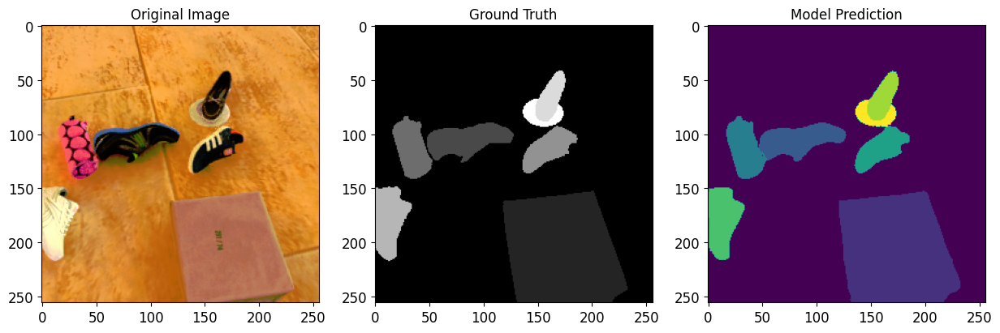

In [ ]:
# Visualize predictions for a few test samples
predictions_multi_class = model_multi_class.predict(X_test[:9])

for i in range(9):
    plt.figure(figsize=(15, 5))

    plt.subplot(1, 3, 1)
    plt.imshow(X_test[i])
    plt.title("Original Image")

    plt.subplot(1, 3, 2)
    plt.imshow(y_test[i].squeeze(), cmap='gray')
    plt.title("Ground Truth")

    plt.subplot(1, 3, 3)
    plt.imshow(np.argmax(predictions_multi_class[i], axis=-1), cmap='viridis')  # Assuming color map for classes
    plt.title("Model Prediction")

    plt.show()


From the visualizations our model detects the objects correctly

***Calculates Intersection over Union (IoU) and Dice coefficient scores for a multi-class segmentation model, evaluates these metrics for each class, and computes overall scores. ***



In [ ]:
import numpy as np

def calculate_iou(y_true, y_pred):
    intersection = np.logical_and(y_true, y_pred)
    union = np.logical_or(y_true, y_pred)
    iou_score = np.sum(intersection) / np.sum(union)
    return iou_score

def calculate_dice(y_true, y_pred):
    intersection = np.logical_and(y_true, y_pred)
    dice_coefficient = 2.0 * np.sum(intersection) / (np.sum(y_true) + np.sum(y_pred))
    return dice_coefficient

# Assuming X_test is your test set images and y_test_one_hot is the ground truth masks
y_pred_one_hot = model_multi_class.predict(X_test)

# Convert one-hot encoded predictions and ground truth to binary masks
y_pred_binary = np.argmax(y_pred_one_hot, axis=-1)
y_true_binary = np.argmax(y_test_one_hot, axis=-1)

# Calculate IoU and Dice for each class
iou_scores = []
dice_scores = []

for class_id in range(8):
    y_true_class = (y_true_binary == class_id)
    y_pred_class = (y_pred_binary == class_id)

    iou_scores.append(calculate_iou(y_true_class, y_pred_class))
    dice_scores.append(calculate_dice(y_true_class, y_pred_class))

# Calculate overall IoU and Dice
overall_iou = np.mean(iou_scores)
overall_dice = np.mean(dice_scores)

print(f"Overall IoU: {overall_iou:.4f}")
print(f"Overall Dice Coefficient: {overall_dice:.4f}")


14/14 [==============================] - 6s 491ms/step
Overall IoU: 0.8868
Overall Dice Coefficient: 0.9387


Defines functions calculate_iou and calculate_dice to compute Intersection over Union and Dice coefficient, respectively, based on the ground truth and predicted binary masks.

Prediction and Ground Truth Conversion:

Utilizes a multi-class segmentation model (model_multi_class) to predict segmentation masks (y_pred_one_hot) on the test set (X_test).
Converts one-hot encoded predictions and ground truth masks to binary masks.
Class-wise Evaluation:

Iterates through each class ( 8 classes) and calculates IoU and Dice scores for each class separately.
Overall Metrics:

Computes overall IoU and Dice coefficient scores by averaging the class-wise scores.

# Ablation Study

#1- After Changing The Num of Epochs

For instance segmentation , we just change epochs=30

In [ ]:
# Define the U-Net model for multi-class segmentation
def unet_model(input_size=(256, 256, 3), num_classes=8):
    inputs = Input(input_size)

    # Encoder
    conv1 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(inputs)
    conv1 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

    conv2 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool1)
    conv2 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)

    conv3 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool2)
    conv3 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)

    # Bottleneck
    conv4 = Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool3)
    conv4 = Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv4)
    drop4 = Dropout(0.5)(conv4)
    pool4 = MaxPooling2D(pool_size=(2, 2))(drop4)

    conv5 = Conv2D(1024, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool4)
    conv5 = Conv2D(1024, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv5)
    drop5 = Dropout(0.5)(conv5)

    # Decoder
    up6 = Concatenate()([UpSampling2D(size=(2, 2))(drop5), conv4])
    conv6 = Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(up6)
    conv6 = Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv6)

    up7 = Concatenate()([UpSampling2D(size=(2, 2))(conv6), conv3])
    conv7 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(up7)
    conv7 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv7)

    up8 = Concatenate()([UpSampling2D(size=(2, 2))(conv7), conv2])
    conv8 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(up8)
    conv8 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv8)

    up9 = Concatenate()([UpSampling2D(size=(2, 2))(conv8), conv1])
    conv9 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(up9)
    conv9 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv9)

    # Output layer
    conv10 = Conv2D(num_classes, 1, activation='softmax')(conv9)

    model = Model(inputs=inputs, outputs=conv10)

    model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

    return model

# Create the model
model_multi_class_1 = unet_model()

# Display the model summary
model_multi_class_1.summary()

# Train the model
history_multi_class_1 = model_multi_class_1.fit(X_train, y_train_one_hot, validation_split=0.1, epochs=32, batch_size=8)

# Evaluate the multi-class segmentation model
loss_multi_class, accuracy_multi_class = model_multi_class_1.evaluate(X_test, y_test_one_hot)
print(f"Test Loss: {loss_multi_class:.4f}")
print(f"Test Accuracy: {accuracy_multi_class:.4f}")

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_2 (InputLayer)        [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 conv2d_19 (Conv2D)          (None, 256, 256, 64)         1792      ['input_2[0][0]']             
                                                                                                  
 conv2d_20 (Conv2D)          (None, 256, 256, 64)         36928     ['conv2d_19[0][0]']           
                                                                                                  
 max_pooling2d_4 (MaxPoolin  (None, 128, 128, 64)         0         ['conv2d_20[0][0]']           
 g2D)                                                                                       

There is no change in accuracy

**Visualize predictions for a few test samples**

1/1 [==============================] - 0s 211ms/step


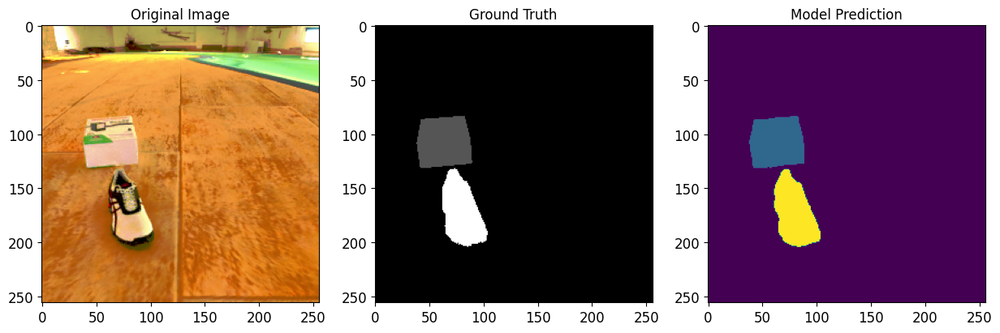

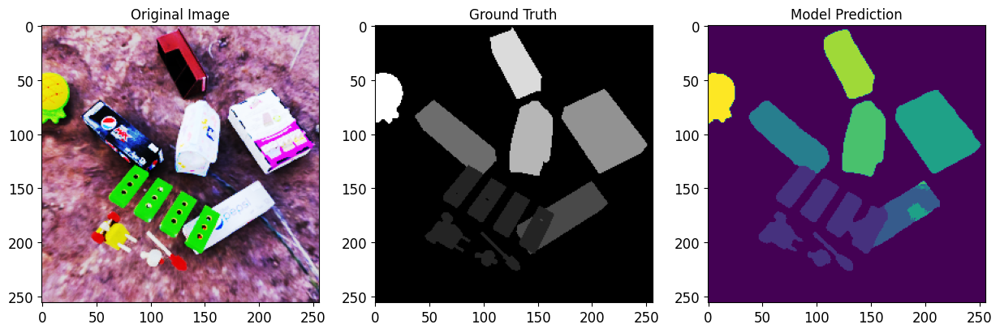

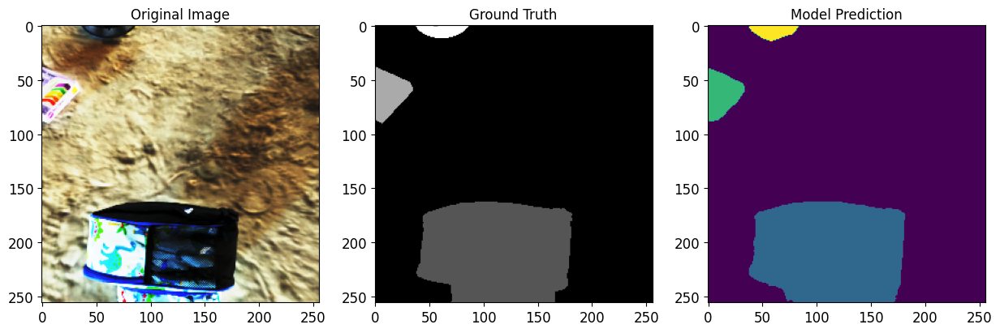

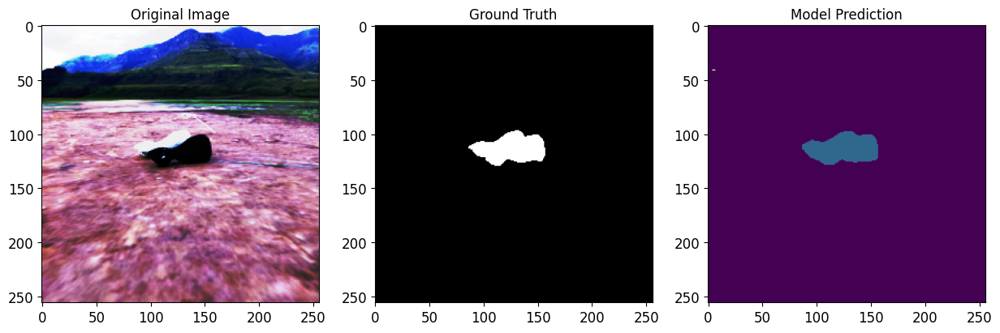

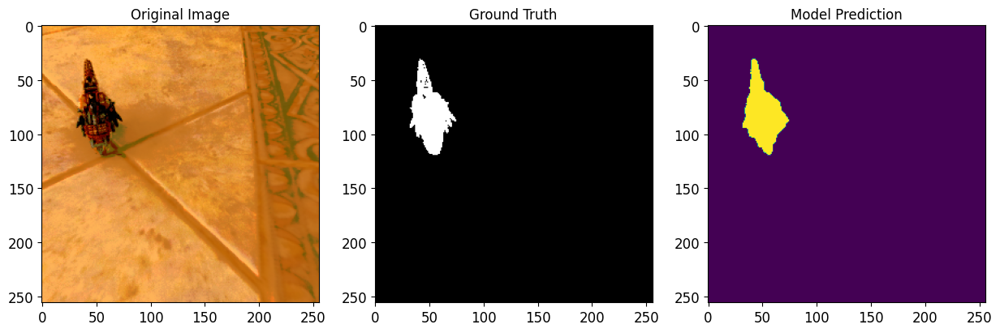

In [ ]:
predictions_multi_class = model_multi_class_1.predict(X_test[:5])

for i in range(5):
    plt.figure(figsize=(15, 5))

    plt.subplot(1, 3, 1)
    plt.imshow(X_test[i])
    plt.title("Original Image")

    plt.subplot(1, 3, 2)
    plt.imshow(y_test[i].squeeze(), cmap='gray')
    plt.title("Ground Truth")

    plt.subplot(1, 3, 3)
    plt.imshow(np.argmax(predictions_multi_class[i], axis=-1), cmap='viridis')  # Assuming color map for classes
    plt.title("Model Prediction")

    plt.show()

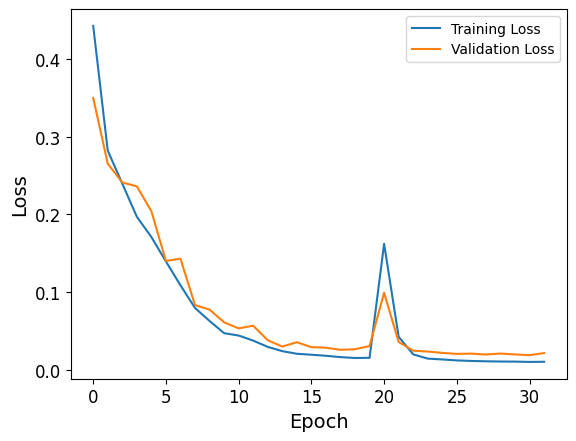

In [ ]:
# Plot the training and validation loss
plt.plot(history_multi_class_1.history['loss'], label='Training Loss')
plt.plot(history_multi_class_1.history['val_loss'], label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

This plot indicates that we should stop before epoch=20.

This change does not demonstrate any improvement

#2- After changing The Learning Rate

 With Learning Rate= 0.01

In [ ]:
# Define the U-Net model for multi-class segmentation
def unet_model(input_size=(256, 256, 3), num_classes=8):
    inputs = Input(input_size)

    # Encoder
    conv1 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(inputs)
    conv1 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

    conv2 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool1)
    conv2 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)

    conv3 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool2)
    conv3 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)

    # Bottleneck
    conv4 = Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool3)
    conv4 = Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv4)
    drop4 = Dropout(0.5)(conv4)
    pool4 = MaxPooling2D(pool_size=(2, 2))(drop4)

    conv5 = Conv2D(1024, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool4)
    conv5 = Conv2D(1024, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv5)
    drop5 = Dropout(0.5)(conv5)

    # Decoder
    up6 = Concatenate()([UpSampling2D(size=(2, 2))(drop5), conv4])
    conv6 = Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(up6)
    conv6 = Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv6)

    up7 = Concatenate()([UpSampling2D(size=(2, 2))(conv6), conv3])
    conv7 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(up7)
    conv7 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv7)

    up8 = Concatenate()([UpSampling2D(size=(2, 2))(conv7), conv2])
    conv8 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(up8)
    conv8 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv8)

    up9 = Concatenate()([UpSampling2D(size=(2, 2))(conv8), conv1])
    conv9 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(up9)
    conv9 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv9)

    # Output layer
    conv10 = Conv2D(num_classes, 1, activation='softmax')(conv9)

    model = Model(inputs=inputs, outputs=conv10)

    model.compile(optimizer=Adam(learning_rate=0.01), loss='categorical_crossentropy', metrics=['accuracy'])

    return model

# Create the model
model_multi_class = unet_model()

# Display the model summary
model_multi_class.summary()

# Train the model
history_multi_class = model_multi_class.fit(X_train, y_train_one_hot, validation_split=0.1, epochs=20, batch_size=8)

# Evaluate the multi-class segmentation model
loss_multi_class, accuracy_multi_class = model_multi_class.evaluate(X_test, y_test_one_hot)
print(f"Test Loss: {loss_multi_class:.4f}")
print(f"Test Accuracy: {accuracy_multi_class:.4f}")

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, 256, 256, 64)         1792      ['input_1[0][0]']             
                                                                                                  
 conv2d_1 (Conv2D)           (None, 256, 256, 64)         36928     ['conv2d[0][0]']              
                                                                                                  
 max_pooling2d (MaxPooling2  (None, 128, 128, 64)         0         ['conv2d_1[0][0]']            
 D)                                                                                           

It give us lower accuracy
Test Accuracy: 0.8947

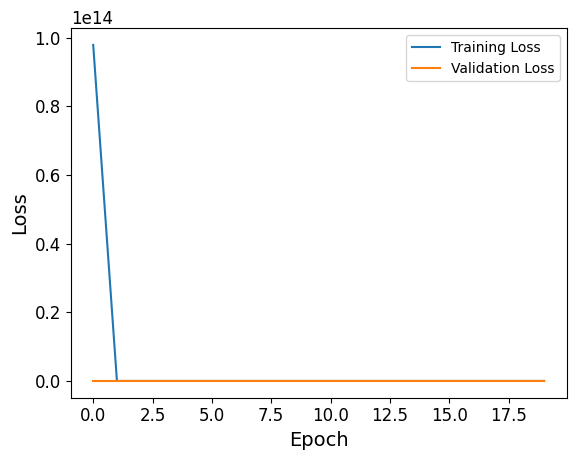

In [ ]:
# Plot the training and validation loss
plt.plot(history_multi_class.history['loss'], label='Training Loss')
plt.plot(history_multi_class.history['val_loss'], label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

It indicates poor performance.

1/1 [==============================] - 4s 4s/step


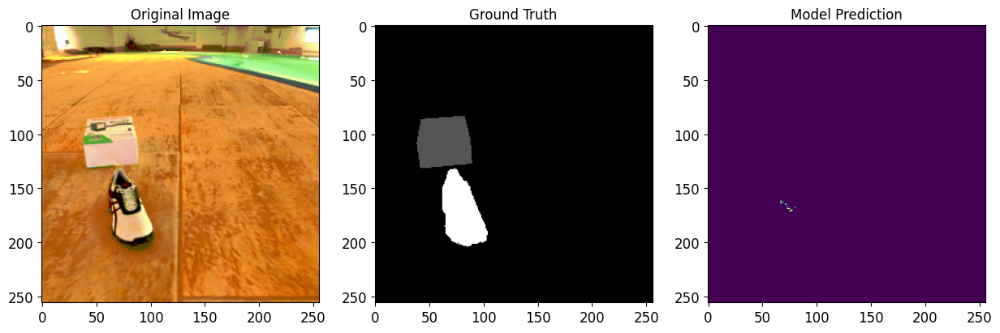

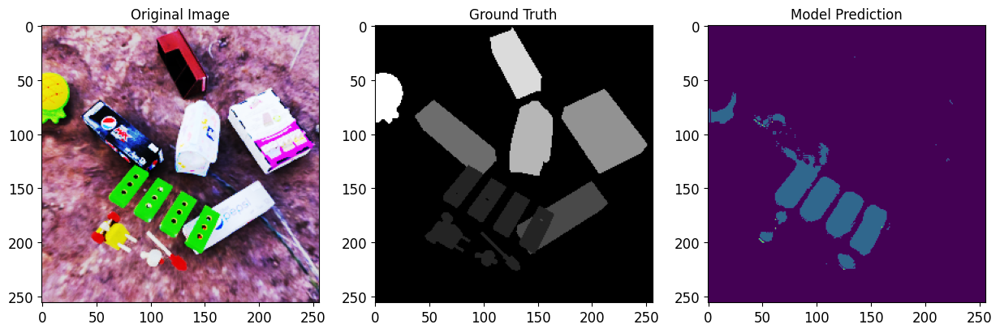

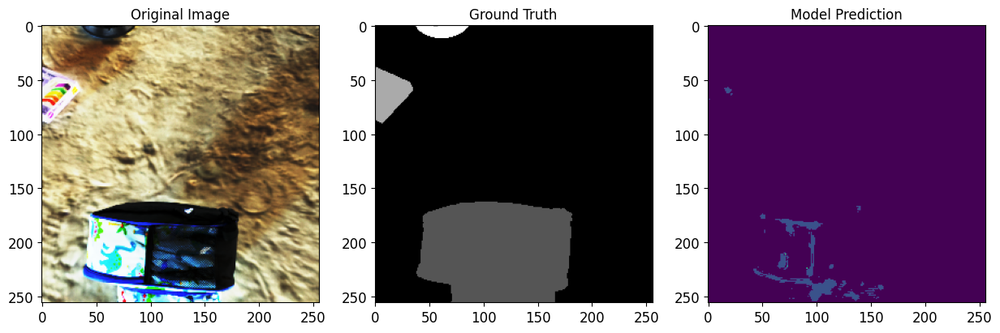

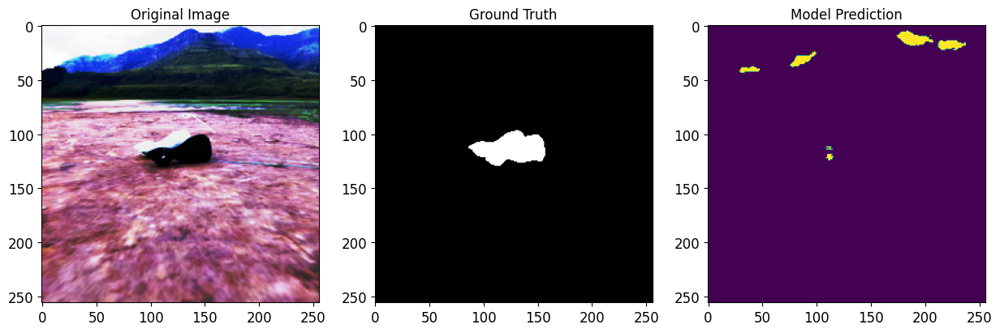

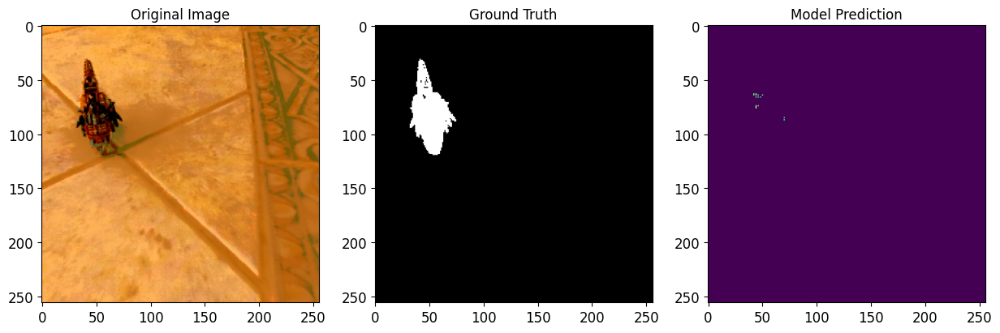

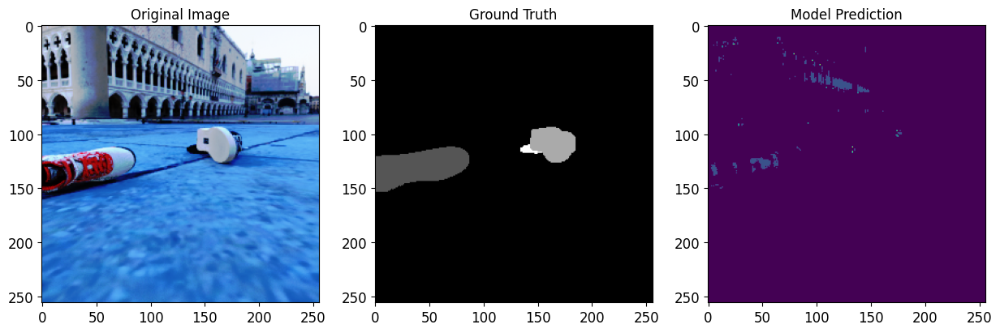

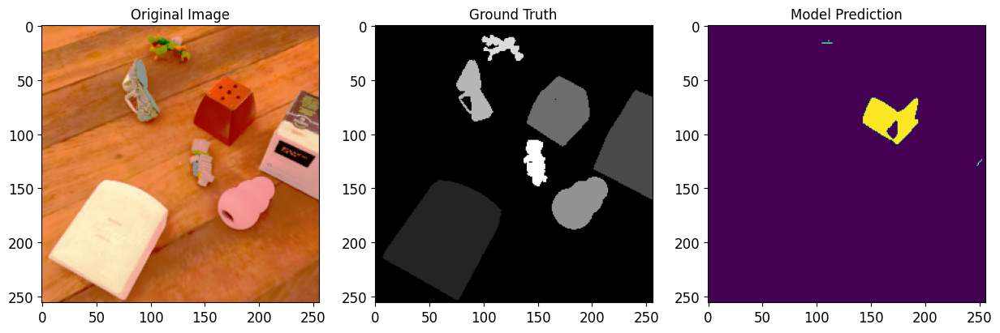

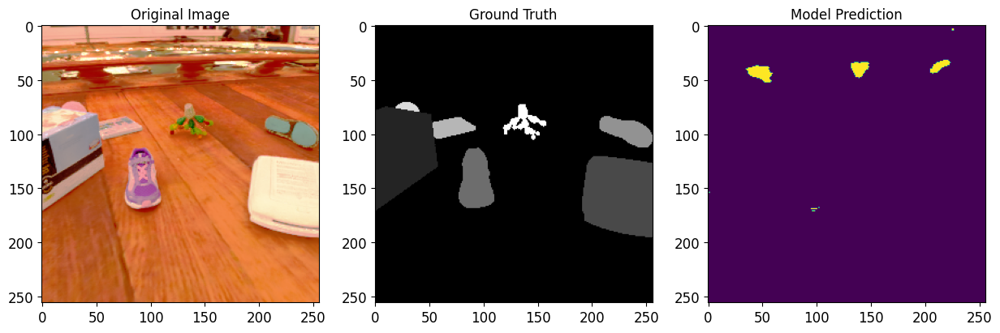

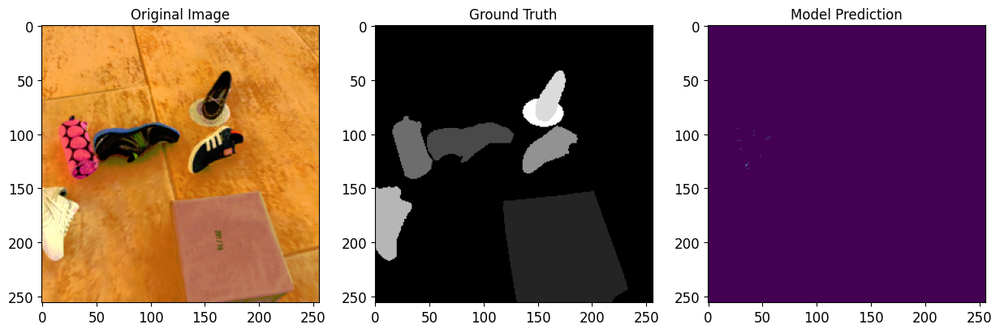

In [ ]:
# Visualize predictions for a few test samples
predictions_multi_class = model_multi_class.predict(X_test[:9])

for i in range(9):
    plt.figure(figsize=(15, 5))

    plt.subplot(1, 3, 1)
    plt.imshow(X_test[i])
    plt.title("Original Image")

    plt.subplot(1, 3, 2)
    plt.imshow(y_test[i].squeeze(), cmap='gray')
    plt.title("Ground Truth")

    plt.subplot(1, 3, 3)
    plt.imshow(np.argmax(predictions_multi_class[i], axis=-1), cmap='viridis')  # Assuming color map for classes
    plt.title("Model Prediction")

    plt.show()

The model does not provide accurate detection for each object.

**With Learning Rate= 0.00001**

In [ ]:
# Define the U-Net model for multi-class segmentation
def unet_model(input_size=(256, 256, 3), num_classes=8):
    inputs = Input(input_size)

    # Encoder
    conv1 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(inputs)
    conv1 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

    conv2 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool1)
    conv2 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)

    conv3 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool2)
    conv3 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)

    # Bottleneck
    conv4 = Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool3)
    conv4 = Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv4)
    drop4 = Dropout(0.5)(conv4)
    pool4 = MaxPooling2D(pool_size=(2, 2))(drop4)

    conv5 = Conv2D(1024, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool4)
    conv5 = Conv2D(1024, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv5)
    drop5 = Dropout(0.5)(conv5)

    # Decoder
    up6 = Concatenate()([UpSampling2D(size=(2, 2))(drop5), conv4])
    conv6 = Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(up6)
    conv6 = Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv6)

    up7 = Concatenate()([UpSampling2D(size=(2, 2))(conv6), conv3])
    conv7 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(up7)
    conv7 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv7)

    up8 = Concatenate()([UpSampling2D(size=(2, 2))(conv7), conv2])
    conv8 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(up8)
    conv8 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv8)

    up9 = Concatenate()([UpSampling2D(size=(2, 2))(conv8), conv1])
    conv9 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(up9)
    conv9 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv9)

    # Output layer
    conv10 = Conv2D(num_classes, 1, activation='softmax')(conv9)

    model = Model(inputs=inputs, outputs=conv10)

    model.compile(optimizer=Adam(learning_rate=0.00001), loss='categorical_crossentropy', metrics=['accuracy'])

    return model

# Create the model
model_multi_class = unet_model()

# Display the model summary
model_multi_class.summary()

# Train the model
history_multi_class = model_multi_class.fit(X_train, y_train_one_hot, validation_split=0.1, epochs=20, batch_size=8)

# Evaluate the multi-class segmentation model
loss_multi_class, accuracy_multi_class = model_multi_class.evaluate(X_test, y_test_one_hot)
print(f"Test Loss: {loss_multi_class:.4f}")
print(f"Test Accuracy: {accuracy_multi_class:.4f}")

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, 256, 256, 64)         1792      ['input_1[0][0]']             
                                                                                                  
 conv2d_1 (Conv2D)           (None, 256, 256, 64)         36928     ['conv2d[0][0]']              
                                                                                                  
 max_pooling2d (MaxPooling2  (None, 128, 128, 64)         0         ['conv2d_1[0][0]']            
 D)                                                                                           

Test Loss: 0.1232 and Test Accuracy: 0.9633. While this result is an improvement over the first change in learning rate, it is noteworthy that our initial model during the training phase exhibited superior accuracy at 0.9922.


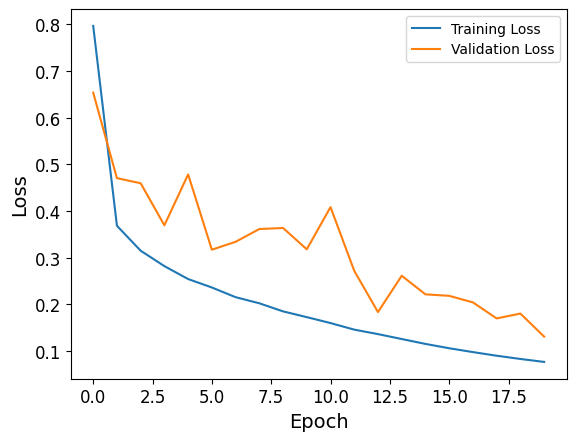

In [ ]:
# Plot the training and validation loss
plt.plot(history_multi_class.history['loss'], label='Training Loss')
plt.plot(history_multi_class.history['val_loss'], label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

Not give us the perfect results

1/1 [==============================] - 4s 4s/step


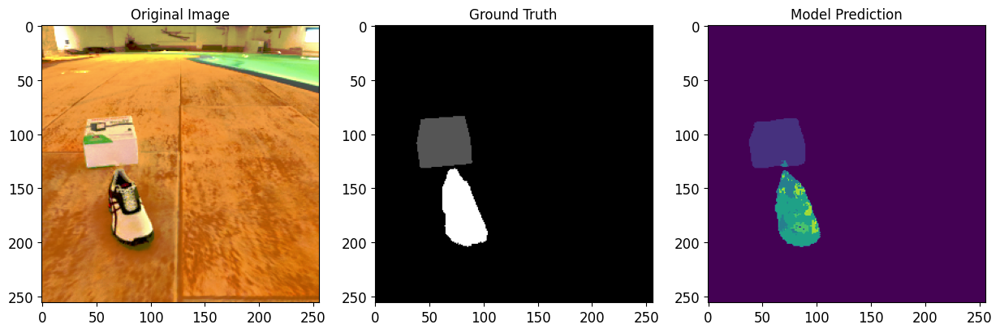

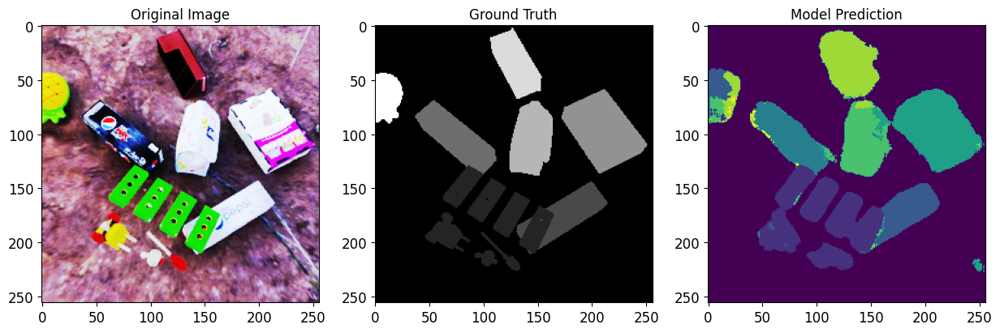

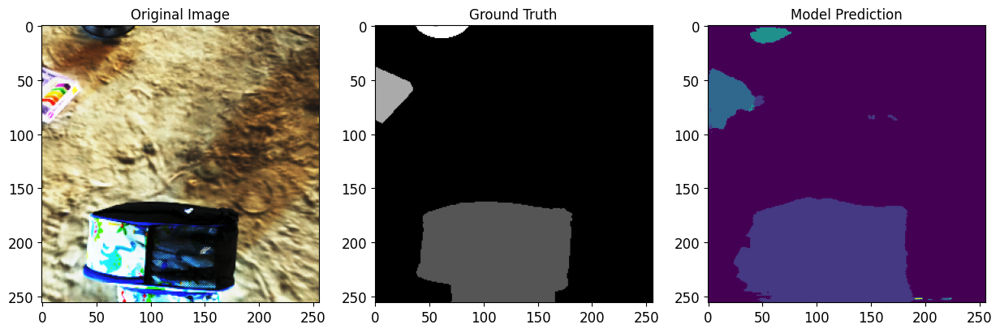

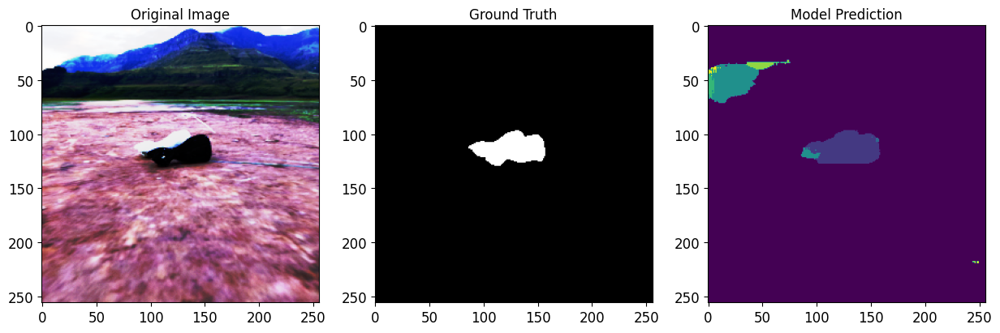

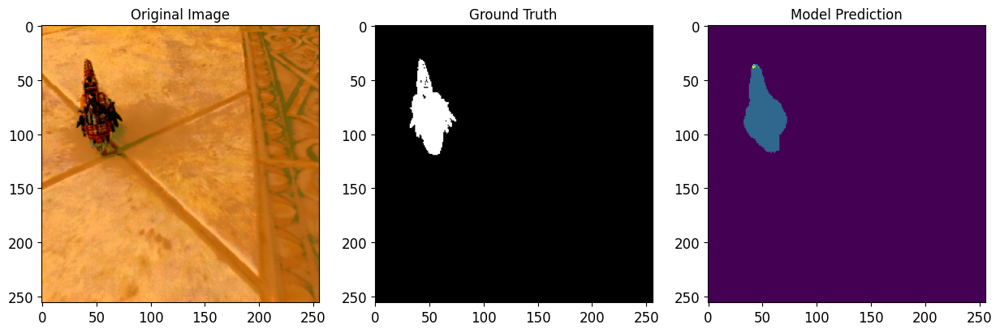

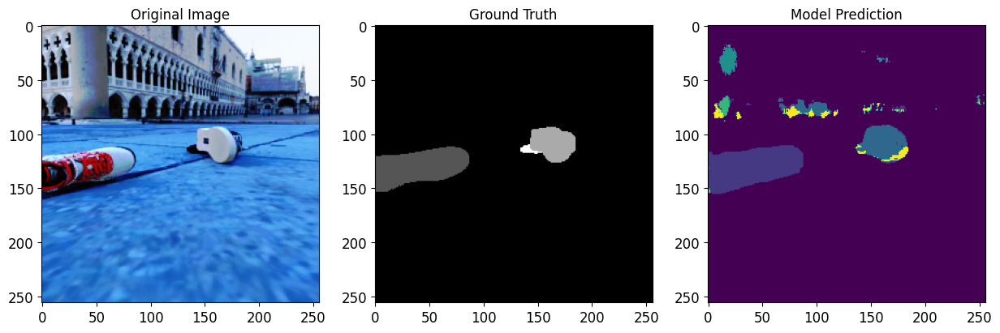

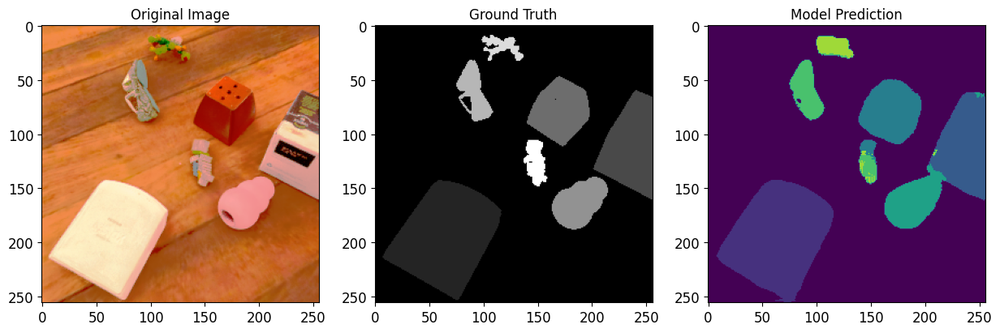

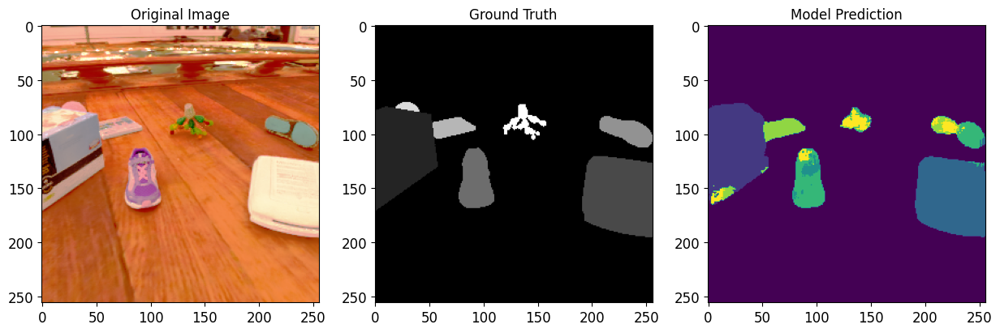

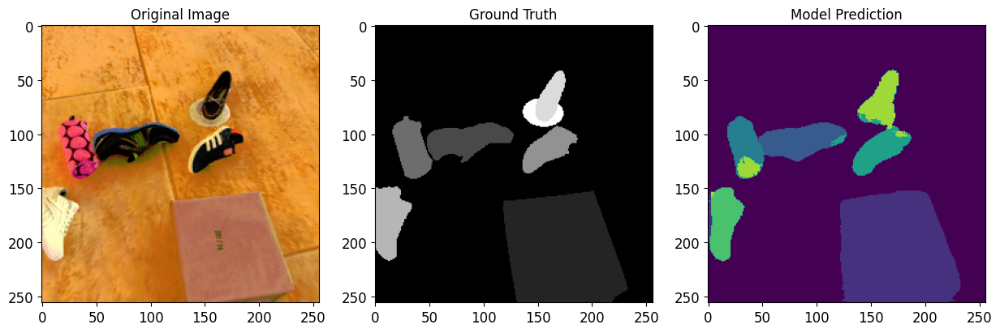

In [ ]:
# Visualize predictions for a few test samples
predictions_multi_class = model_multi_class.predict(X_test[:9])

for i in range(9):
    plt.figure(figsize=(15, 5))

    plt.subplot(1, 3, 1)
    plt.imshow(X_test[i])
    plt.title("Original Image")

    plt.subplot(1, 3, 2)
    plt.imshow(y_test[i].squeeze(), cmap='gray')
    plt.title("Ground Truth")

    plt.subplot(1, 3, 3)
    plt.imshow(np.argmax(predictions_multi_class[i], axis=-1), cmap='viridis')  # Assuming color map for classes
    plt.title("Model Prediction")

    plt.show()

So, our first model is the best

# 3- Changing The  Architecture of U-Net

# 1-Instance segmentation

The number of convolutional layers added in the last stage of the decoder.

In [ ]:
#1
from keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, Dropout, Concatenate
from keras.models import Model
from keras.optimizers import Adam

def modified_unet_model(input_size=(256, 256, 3), num_classes=8):
    inputs = Input(input_size)

    # Encoder
    conv1 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(inputs)
    conv1 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

    conv2 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool1)
    conv2 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)

    conv3 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool2)
    conv3 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)

    # Bottleneck
    conv4 = Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool3)
    conv4 = Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv4)
    drop4 = Dropout(0.5)(conv4)
    pool4 = MaxPooling2D(pool_size=(2, 2))(drop4)

    conv5 = Conv2D(1024, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool4)
    conv5 = Conv2D(1024, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv5)
    drop5 = Dropout(0.5)(conv5)

    # Decoder
    up6 = Concatenate()([UpSampling2D(size=(2, 2))(drop5), conv4])
    conv6 = Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(up6)
    conv6 = Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv6)

    up7 = Concatenate()([UpSampling2D(size=(2, 2))(conv6), conv3])
    conv7 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(up7)
    conv7 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv7)

    up8 = Concatenate()([UpSampling2D(size=(2, 2))(conv7), conv2])
    conv8 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(up8)
    conv8 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv8)

    up9 = Concatenate()([UpSampling2D(size=(2, 2))(conv8), conv1])
    conv9 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(up9)
    conv9 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv9)

    # Output layer
    conv10 = Conv2D(num_classes, 1, activation='softmax')(conv9)

    model = Model(inputs=inputs, outputs=conv10)

    model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

    return model

# Create and train the modified model
model_modified = modified_unet_model()
history_modified = model_modified.fit(X_train, y_train_one_hot, validation_split=0.1, epochs=20, batch_size=8)

# Evaluate the modified model
loss_modified, accuracy_modified = model_modified.evaluate(X_test, y_test_one_hot)
print(f"Test Loss (Modified): {loss_modified:.4f}")
print(f"Test Accuracy (Modified): {accuracy_modified:.4f}")


Epoch 1/20
195/195 [==============================] - 116s 574ms/step - loss: 0.4257 - accuracy: 0.8964 - val_loss: 0.3326 - val_accuracy: 0.9052
Epoch 2/20
195/195 [==============================] - 110s 565ms/step - loss: 0.2877 - accuracy: 0.9156 - val_loss: 0.3476 - val_accuracy: 0.9031
Epoch 3/20
195/195 [==============================] - 110s 565ms/step - loss: 0.2432 - accuracy: 0.9253 - val_loss: 0.2450 - val_accuracy: 0.9255
Epoch 4/20
195/195 [==============================] - 110s 566ms/step - loss: 0.2020 - accuracy: 0.9360 - val_loss: 0.2262 - val_accuracy: 0.9321
Epoch 5/20
195/195 [==============================] - 110s 566ms/step - loss: 0.1735 - accuracy: 0.9443 - val_loss: 0.1854 - val_accuracy: 0.9464
Epoch 6/20
195/195 [==============================] - 110s 566ms/step - loss: 0.1381 - accuracy: 0.9555 - val_loss: 0.1400 - val_accuracy: 0.9559
Epoch 7/20
195/195 [==============================] - 110s 566ms/step - loss: 0.1223 - accuracy: 0.9605 - val_loss: 0.1303 -

It yields a lower accuracy with Test Accuracy: 0.9876, while our initial model achieves a higher accuracy with Test Accuracy: 0.9922.

Visualization for original image,original and predicted masks

14/14 [==============================] - 6s 439ms/step


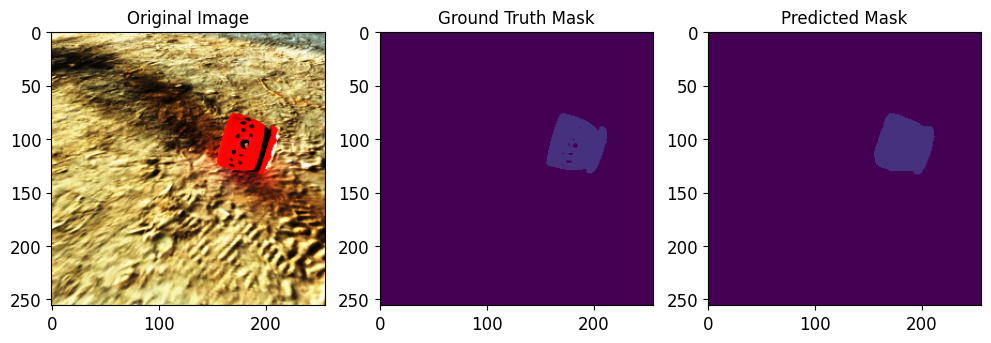

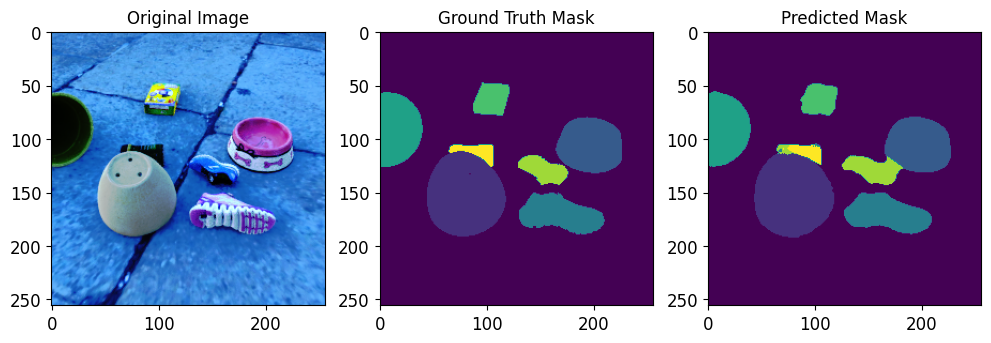

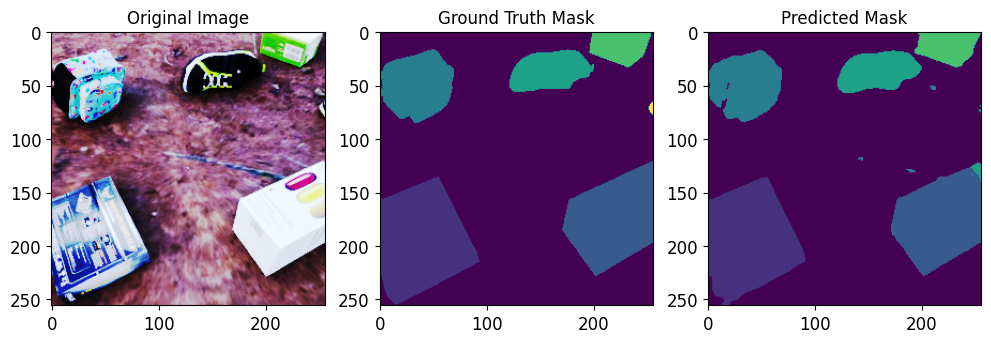

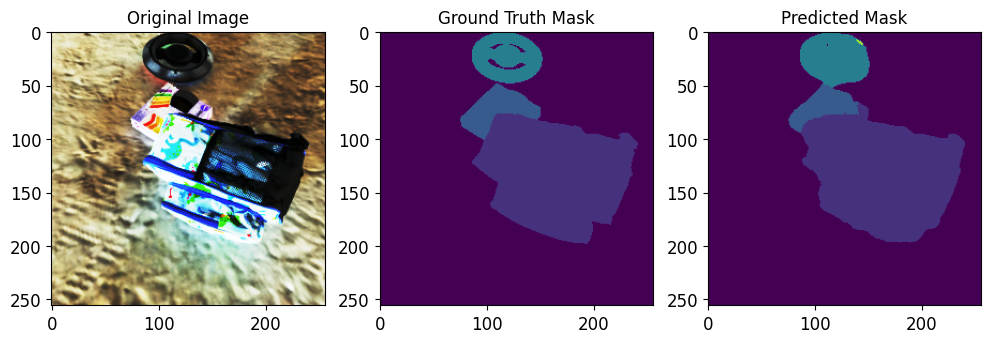

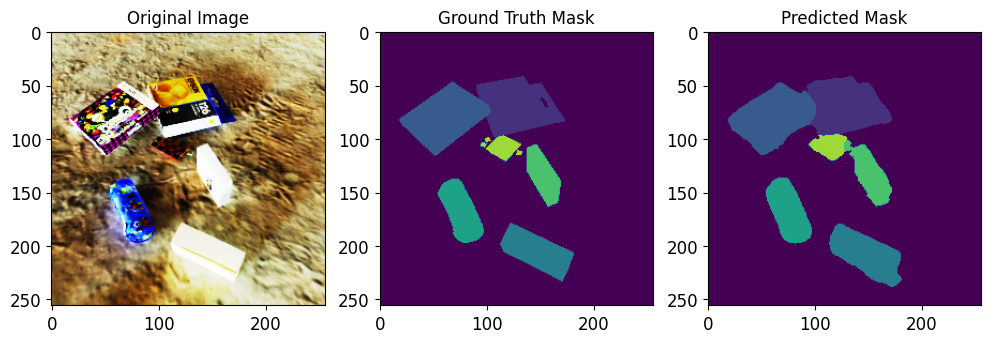

In [ ]:
import matplotlib.pyplot as plt
import random

# Function to visualize original and predicted masks
def visualize_predictions(model, X_test, y_test, num_samples=5):
    # Randomly select samples for visualization
    samples = random.sample(range(len(X_test)), num_samples)

    # Make predictions
    predictions = model.predict(X_test)

    # Plot the original and predicted masks
    for i, sample_idx in enumerate(samples):
        plt.figure(figsize=(12, 4))

        # Plot original image
        plt.subplot(1, 3, 1)
        plt.imshow(X_test[sample_idx])
        plt.title('Original Image')

        # Plot ground truth mask
        plt.subplot(1, 3, 2)
        plt.imshow(np.argmax(y_test[sample_idx], axis=-1), cmap='viridis', vmin=0, vmax=8 - 1)
        plt.title('Ground Truth Mask')

        # Plot predicted mask
        plt.subplot(1, 3, 3)
        plt.imshow(np.argmax(predictions[sample_idx], axis=-1), cmap='viridis', vmin=0, vmax=8 - 1)
        plt.title('Predicted Mask')

        plt.show()

# Visualize predictions
visualize_predictions(model_modified, X_test, y_test_one_hot)


Calculates Intersection over Union (IoU) and Dice scores for each class, comparing the predicted segmentation masks (predictions_modified) with the ground truth (y_test_one_hot). It then prints individual IoU and Dice scores for each class and concludes with the average IoU and Dice scores across all classes. The metrics are used to assess the segmentation model's performance on a per-class and overall basis.

In [ ]:
import numpy as np

def calculate_iou(y_true, y_pred):
    intersection = np.sum(np.logical_and(y_true, y_pred))
    union = np.sum(np.logical_or(y_true, y_pred))
    iou = intersection / union
    return iou

def calculate_dice(y_true, y_pred):
    intersection = np.sum(np.logical_and(y_true, y_pred))
    dice = (2.0 * intersection) / (np.sum(y_true) + np.sum(y_pred))
    return dice

# Make predictions on the test set
predictions_modified = model_modified.predict(X_test)

# Convert one-hot encoded masks to categorical masks
y_test_categorical = np.argmax(y_test_one_hot, axis=-1)
predictions_categorical = np.argmax(predictions_modified, axis=-1)

# Calculate IoU and Dice for each class
iou_scores = []
dice_scores = []

for class_id in range(8):
    y_true_class = (y_test_categorical == class_id).astype(int)
    y_pred_class = (predictions_categorical == class_id).astype(int)

    iou_class = calculate_iou(y_true_class, y_pred_class)
    dice_class = calculate_dice(y_true_class, y_pred_class)

    iou_scores.append(iou_class)
    dice_scores.append(dice_class)

# Print IoU and Dice scores for each class
for class_id in range(8):
    print(f"Class {class_id} - IoU: {iou_scores[class_id]:.4f}, Dice: {dice_scores[class_id]:.4f}")

# Print the average IoU and Dice scores
average_iou = np.mean(iou_scores)
average_dice = np.mean(dice_scores)
print(f"\nAverage IoU: {average_iou:.4f}, Average Dice: {average_dice:.4f}")


14/14 [==============================] - 6s 443ms/step
Class 0 - IoU: 0.9908, Dice: 0.9954
Class 1 - IoU: 0.9059, Dice: 0.9506
Class 2 - IoU: 0.8427, Dice: 0.9146
Class 3 - IoU: 0.7985, Dice: 0.8879
Class 4 - IoU: 0.8420, Dice: 0.9142
Class 5 - IoU: 0.7626, Dice: 0.8653
Class 6 - IoU: 0.7026, Dice: 0.8253
Class 7 - IoU: 0.6768, Dice: 0.8072

Average IoU: 0.8152, Average Dice: 0.8951


Displays lower IoU: 0.8152 and Dice: 0.8951 compared to the first model which are Overall IoU: 0.8868 and Overall Dice Coefficient: 0.9387

Second Architecture

Encoder: It uses two consecutive convolutional layers followed by batch normalization for each level in the encoder.

Bottleneck: It employs two consecutive convolutional layers followed by batch normalization and dropout (with a dropout rate of 0.5) at the bottleneck.

Decoder: Up-sampling in the decoder is done using UpSampling2D layers, and each level in the decoder has two consecutive convolutional layers followed by batch normalization.

  Use a separate Dropout layer at the bottleneck, batch normalization layers are added after each convolutional layer and before the activation function. Batch normalization is known to stabilize and accelerate the training process by normalizing the inputs to a layer, helping with faster

In [ ]:
#2
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, concatenate, BatchNormalization, Activation
from keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, Dropout, Concatenate
from keras.models import Model
from keras.optimizers import Adam

def unet_model_alternative(input_size=(256, 256, 3), num_classes=8):
    inputs = Input(input_size)

    # Encoder
    conv1 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(inputs)
    conv1 = BatchNormalization()(conv1)
    conv1 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv1)
    conv1 = BatchNormalization()(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

    conv2 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool1)
    conv2 = BatchNormalization()(conv2)
    conv2 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv2)
    conv2 = BatchNormalization()(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)

    conv3 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool2)
    conv3 = BatchNormalization()(conv3)
    conv3 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv3)
    conv3 = BatchNormalization()(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)

    # Bottleneck
    conv4 = Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool3)
    conv4 = BatchNormalization()(conv4)
    conv4 = Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv4)
    conv4 = BatchNormalization()(conv4)
    drop4 = Dropout(0.5)(conv4)
    pool4 = MaxPooling2D(pool_size=(2, 2))(drop4)

    conv5 = Conv2D(1024, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool4)
    conv5 = BatchNormalization()(conv5)
    conv5 = Conv2D(1024, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv5)
    conv5 = BatchNormalization()(conv5)
    drop5 = Dropout(0.5)(conv5)

    # Decoder
    up6 = concatenate([UpSampling2D(size=(2, 2))(drop5), conv4], axis=3)
    conv6 = Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(up6)
    conv6 = BatchNormalization()(conv6)
    conv6 = Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv6)
    conv6 = BatchNormalization()(conv6)

    up7 = concatenate([UpSampling2D(size=(2, 2))(conv6), conv3], axis=3)
    conv7 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(up7)
    conv7 = BatchNormalization()(conv7)
    conv7 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv7)
    conv7 = BatchNormalization()(conv7)

    up8 = concatenate([UpSampling2D(size=(2, 2))(conv7), conv2], axis=3)
    conv8 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(up8)
    conv8 = BatchNormalization()(conv8)
    conv8 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv8)
    conv8 = BatchNormalization()(conv8)

    up9 = concatenate([UpSampling2D(size=(2, 2))(conv8), conv1], axis=3)
    conv9 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(up9)
    conv9 = BatchNormalization()(conv9)
    conv9 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv9)
    conv9 = BatchNormalization()(conv9)

    # Output layer
    conv10 = Conv2D(num_classes, 1, activation='softmax')(conv9)

    model = Model(inputs=inputs, outputs=conv10)

    model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

    return model

# Create the model
model_multi_class_alternative = unet_model_alternative()

# Display the model summary
model_multi_class_alternative.summary()

# Train the model
history_multi_class_alternative = model_multi_class_alternative.fit(X_train, y_train_one_hot, validation_split=0.1, epochs=20, batch_size=8)

# Evaluate the multi-class segmentation model
loss_multi_class_alternative, accuracy_multi_class_alternative = model_multi_class_alternative.evaluate(X_test, y_test_one_hot)
print(f"Test Loss: {loss_multi_class_alternative:.4f}")
print(f"Test Accuracy: {accuracy_multi_class_alternative:.4f}")

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_3 (InputLayer)        [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 conv2d_27 (Conv2D)          (None, 256, 256, 64)         1792      ['input_3[0][0]']             
                                                                                                  
 batch_normalization_26 (Ba  (None, 256, 256, 64)         256       ['conv2d_27[0][0]']           
 tchNormalization)                                                                                
                                                                                                  
 conv2d_28 (Conv2D)          (None, 256, 256, 64)         36928     ['batch_normalization_26

The performance of the first model is still superior.

1/1 [==============================] - 4s 4s/step


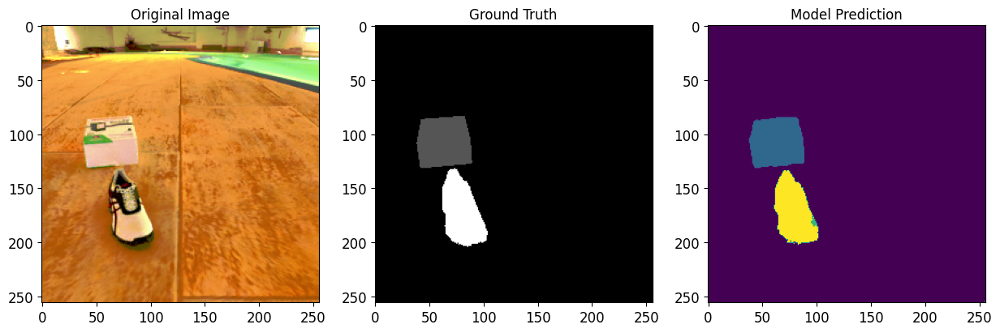

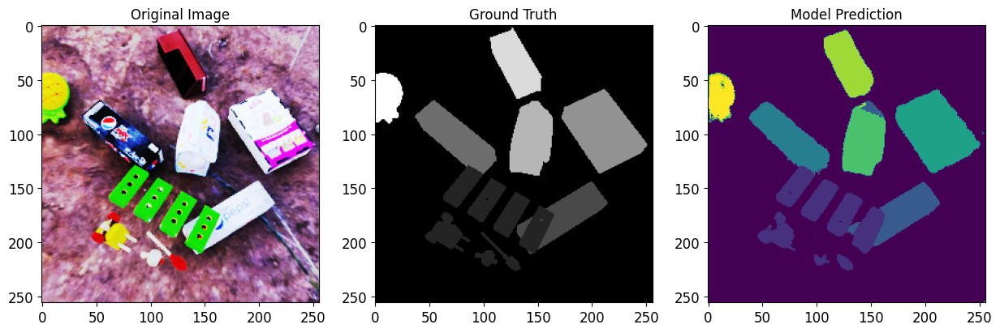

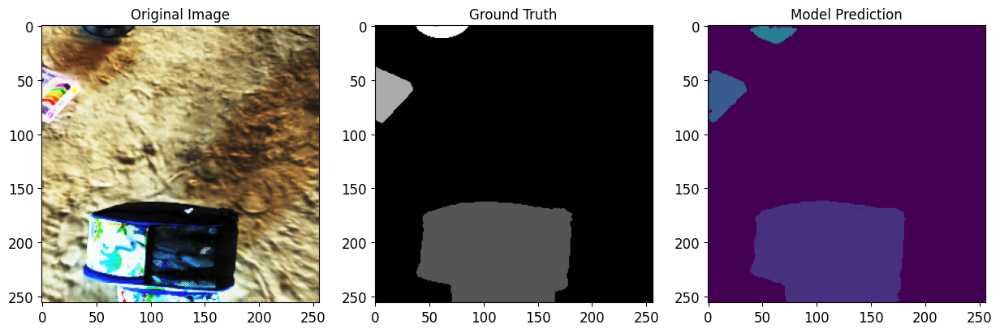

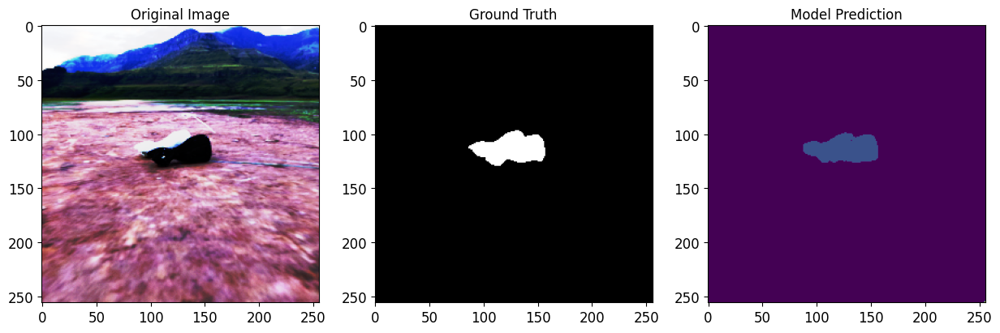

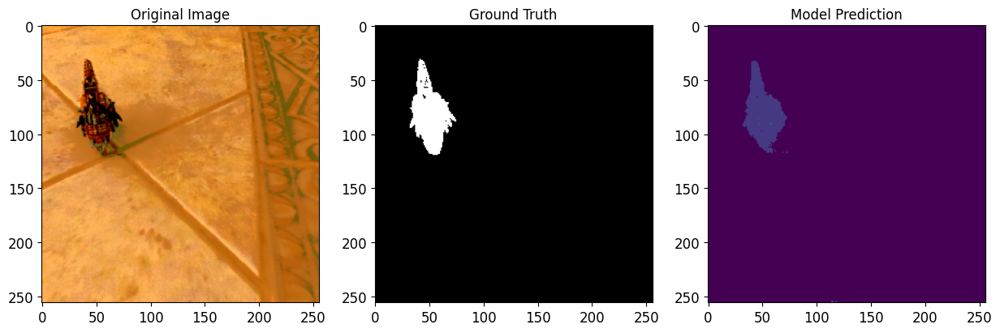

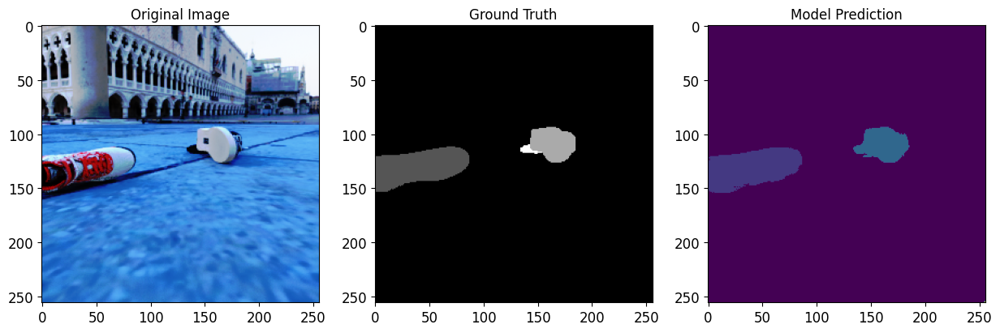

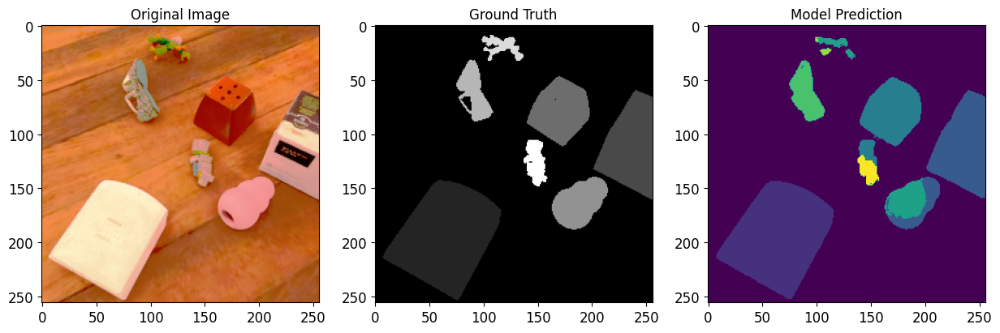

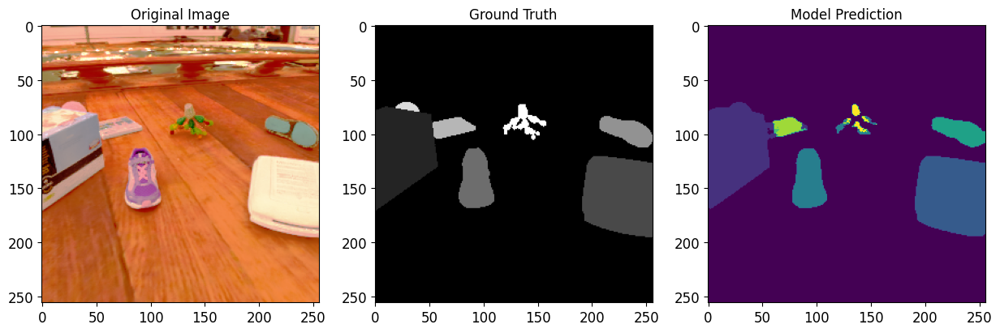

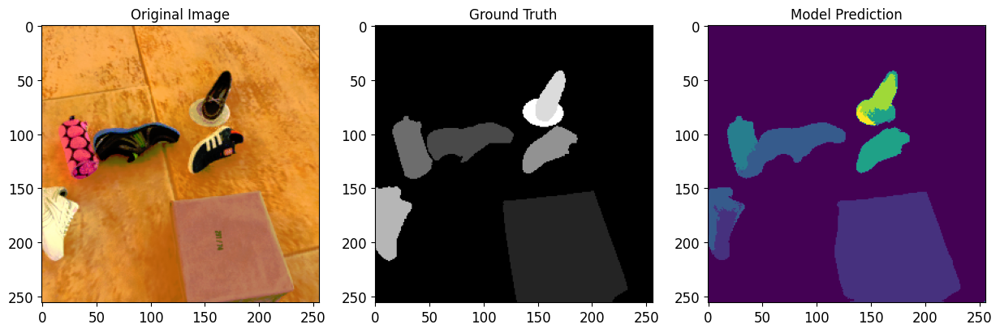

In [ ]:
# Visualize predictions for a few test samples
predictions_multi_class = model_multi_class_alternative.predict(X_test[:9])

for i in range(9):
    plt.figure(figsize=(15, 5))

    plt.subplot(1, 3, 1)
    plt.imshow(X_test[i])
    plt.title("Original Image")

    plt.subplot(1, 3, 2)
    plt.imshow(y_test[i].squeeze(), cmap='gray')
    plt.title("Ground Truth")

    plt.subplot(1, 3, 3)
    plt.imshow(np.argmax(predictions_multi_class[i], axis=-1), cmap='viridis')  # Assuming color map for classes
    plt.title("Model Prediction")

    plt.show()

Exhibits good performance in detecting individual objects.

Calculates Intersection over Union (IoU) and Dice scores for each class, comparing the predicted segmentation masks (predictions_modified) with the ground truth (y_test_one_hot). It then prints individual IoU and Dice scores for each class and concludes with the average IoU and Dice scores across all classes. The metrics are used to assess the segmentation model's performance on a per-class and overall basis.

In [ ]:
import numpy as np
# Assuming X_test is your test set images and y_test_one_hot is the ground truth masks
y_pred_one_hot = model_multi_class_alternative.predict(X_test)

# Convert one-hot encoded predictions and ground truth to binary masks
y_pred_binary = np.argmax(y_pred_one_hot, axis=-1)
y_true_binary = np.argmax(y_test_one_hot, axis=-1)

# Calculate IoU and Dice for each class
iou_scores = []
dice_scores = []

for class_id in range(8):
    y_true_class = (y_true_binary == class_id)
    y_pred_class = (y_pred_binary == class_id)

    iou_scores.append(calculate_iou(y_true_class, y_pred_class))
    dice_scores.append(calculate_dice(y_true_class, y_pred_class))

# Calculate overall IoU and Dice
overall_iou = np.mean(iou_scores)
overall_dice = np.mean(dice_scores)

print(f"Overall IoU: {overall_iou:.4f}")
print(f"Overall Dice Coefficient: {overall_dice:.4f}")

14/14 [==============================] - 7s 509ms/step
Overall IoU: 0.7179
Overall Dice Coefficient: 0.8215


Displays lower Overall IoU: 0.7179 and
Overall Dice Coefficient: 0.8215 compared to the first model which are Overall IoU: 0.8868 and Overall Dice Coefficient: 0.9387

**So, the initial architecture we used in the beginning performed better among these two architectures.**





#  Semantic Segmentation


Normalization Layers:Added Batch Normalization after each convolutional layer for improved training stability.

Skip Connection Concatenation:Explicitly specified the concatenation axis as the last axis (-1).

Output Activation:Utilized a sigmoid activation function in the output layer for binary segmentation.

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, 256, 256, 64)         1792      ['input_1[0][0]']             
                                                                                                  
 batch_normalization (Batch  (None, 256, 256, 64)         256       ['conv2d[0][0]']              
 Normalization)                                                                                   
                                                                                                  
 conv2d_1 (Conv2D)           (None, 256, 256, 64)         36928     ['batch_normalization[0][0

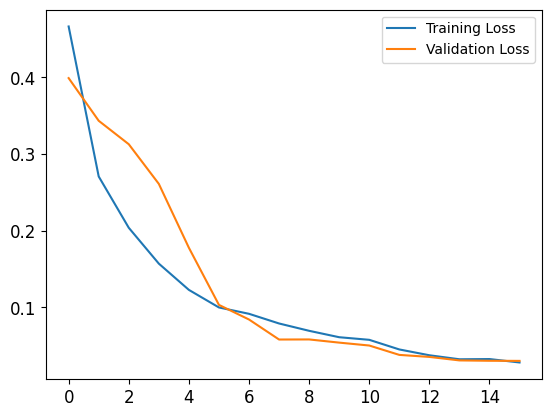

14/14 [==============================] - 19s 783ms/step - loss: 0.0301 - accuracy: 0.9927
Test Loss (Alternative): 0.0301
Test Accuracy (Alternative): 0.9927


In [ ]:
from keras.layers import Activation, BatchNormalization

def unet_model_binary_alternative(input_size=(256, 256, 3)):
    inputs = Input(input_size)

    # Encoder
    conv1 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(inputs)
    conv1 = BatchNormalization()(conv1)
    conv1 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv1)
    conv1 = BatchNormalization()(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

    conv2 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool1)
    conv2 = BatchNormalization()(conv2)
    conv2 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv2)
    conv2 = BatchNormalization()(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)

    conv3 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool2)
    conv3 = BatchNormalization()(conv3)
    conv3 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv3)
    conv3 = BatchNormalization()(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)

    # Bottleneck
    conv4 = Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(pool3)
    conv4 = BatchNormalization()(conv4)
    conv4 = Conv2D(512, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv4)
    conv4 = BatchNormalization()(conv4)

    # Decoder
    up5 = UpSampling2D(size=(2, 2))(conv4)
    up5 = concatenate([up5, conv3], axis=-1)
    conv5 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(up5)
    conv5 = BatchNormalization()(conv5)
    conv5 = Conv2D(256, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv5)
    conv5 = BatchNormalization()(conv5)

    up6 = UpSampling2D(size=(2, 2))(conv5)
    up6 = concatenate([up6, conv2], axis=-1)
    conv6 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(up6)
    conv6 = BatchNormalization()(conv6)
    conv6 = Conv2D(128, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv6)
    conv6 = BatchNormalization()(conv6)

    up7 = UpSampling2D(size=(2, 2))(conv6)
    up7 = concatenate([up7, conv1], axis=-1)
    conv7 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(up7)
    conv7 = BatchNormalization()(conv7)
    conv7 = Conv2D(64, 3, activation='relu', padding='same', kernel_initializer='he_normal')(conv7)
    conv7 = BatchNormalization()(conv7)

    # Output layer
    outputs = Conv2D(1, 1, activation='sigmoid')(conv7)

    model = Model(inputs=inputs, outputs=outputs)

    # Compile the model
    model.compile(optimizer=Adam(learning_rate=0.0001), loss='binary_crossentropy', metrics=['accuracy'])

    return model

# Create the alternative U-Net model for binary segmentation
model_binary_alternative = unet_model_binary_alternative()

# Print the model summary
model_binary_alternative.summary()

# Train the alternative model for binary segmentation
history_binary_alternative = model_binary_alternative.fit(X_train_bi, y_train_bi, epochs=16, batch_size=20, validation_data=(X_test_bi, y_test_bi))

# Visualize training history
plt.plot(history_binary_alternative.history['loss'], label='Training Loss')
plt.plot(history_binary_alternative.history['val_loss'], label='Validation Loss')
plt.legend()
plt.show()

# Evaluate the alternative model for binary segmentation
loss_binary_alternative, accuracy_binary_alternative = model_binary_alternative.evaluate(X_test_bi, y_test_bi)
print(f"Test Loss (Alternative): {loss_binary_alternative:.4f}")
print(f"Test Accuracy (Alternative): {accuracy_binary_alternative:.4f}")


It yields a Test Loss of 0.0301 and Test Accuracy of 0.9927, surpassing the accuracy of our initial model, which had a Test Loss of 0.0231 and Test Accuracy of 0.9911.

1/1 [==============================] - 2s 2s/step


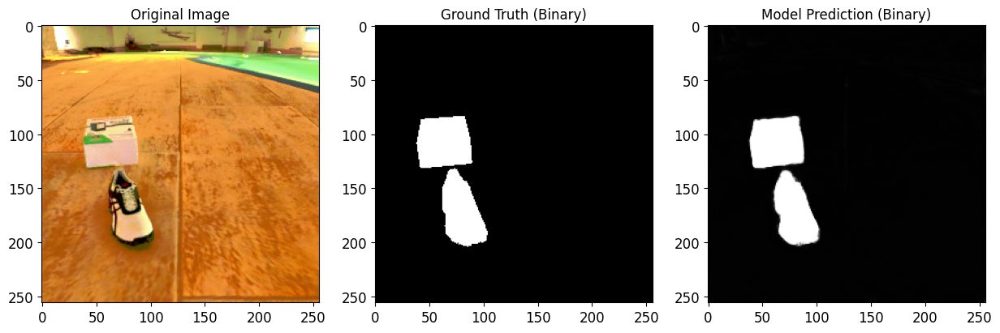

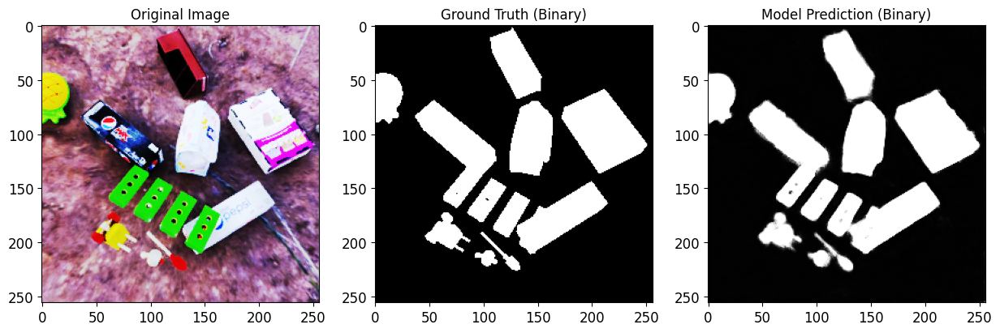

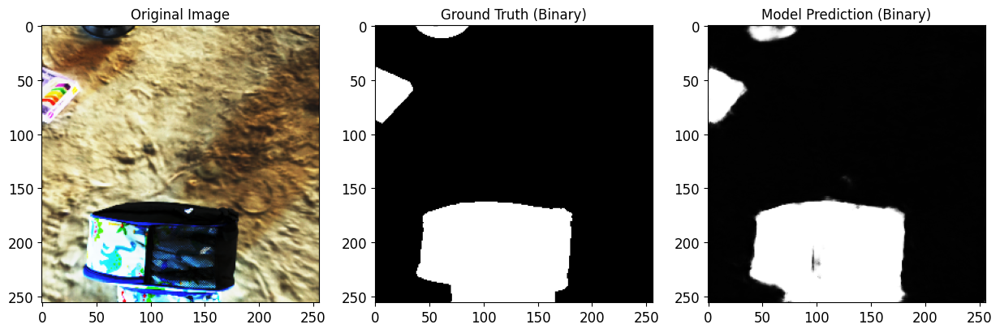

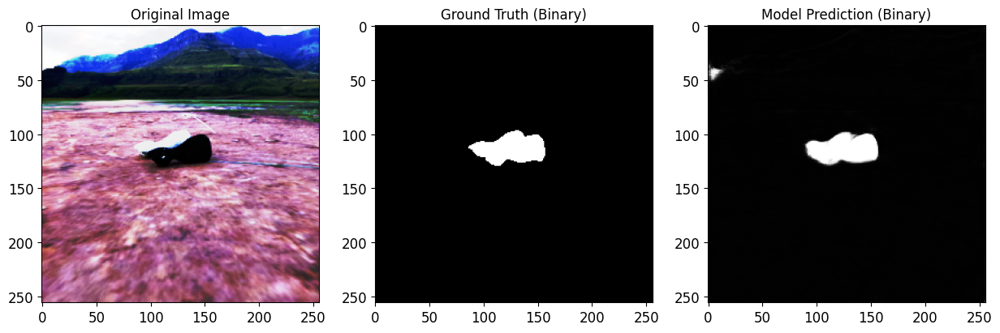

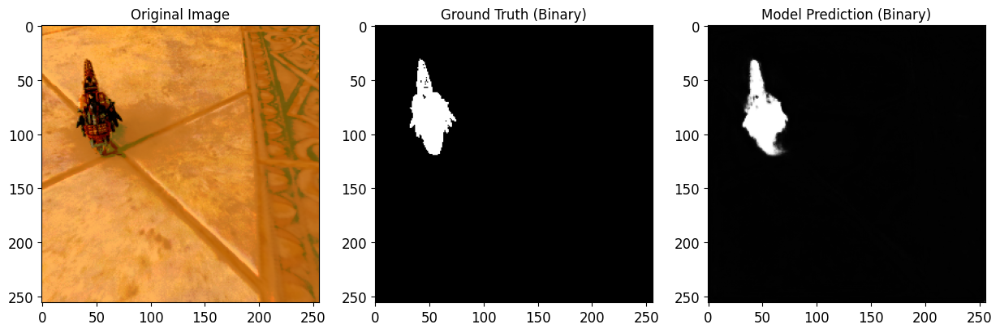

In [ ]:
# Visualize predictions for a few test samples
predictions_binary = model_binary_alternative.predict(X_test_bi[:5])

for i in range(5):
    plt.figure(figsize=(15, 5))

    plt.subplot(1, 3, 1)
    plt.imshow(X_test_bi[i])
    plt.title("Original Image")

    plt.subplot(1, 3, 2)
    plt.imshow(y_test_bi[i].squeeze(), cmap='gray')
    plt.title("Ground Truth (Binary)")

    plt.subplot(1, 3, 3)
    plt.imshow(predictions_binary[i].squeeze(), cmap='gray', vmin=0, vmax=1)
    plt.title("Model Prediction (Binary)")

    plt.show()

Perfect performance

Predicts binary segmentation masks on a test set using an alternative binary segmentation model (model_binary_alternative). It then rounds the predictions to binary values and calculates the Dice coefficient for each sample in the test set, ultimately computing the mean Dice coefficient across all samples.

In [ ]:
# Predict on test set
y_pred_binary = model_binary_alternative.predict(X_test_bi)

# Round predictions to convert to binary values
y_pred_binary = np.round(y_pred_binary)

# Calculate Dice for each sample in the test set
dices = []
#We already define calculate_dice function in the first code
for i in range(len(y_test_bi)):
    dice = calculate_dice(y_test_bi[i], y_pred_binary[i])
    dices.append(dice)

mean_dice = np.mean(dices)
print(f"Mean Dice: {mean_dice:.4f}")


14/14 [==============================] - 5s 410ms/step
Mean Dice: 0.9543


 Predicts binary segmentation masks on a test set using an alternative binary segmentation model (model_binary_alternative). It then rounds the predictions to binary values and calculates the Dice coefficient for each sample in the test set, ultimately computing the mean Dice coefficient across all samples.

In [ ]:
def calculate_iou(y_true, y_pred, smooth=1.0):
    intersection = np.sum(np.abs(np.round(y_true) * np.round(y_pred)))
    union = np.sum(np.abs(np.round(y_true) + np.round(y_pred))) - intersection
    iou = (intersection + smooth) / (union + smooth)
    return np.clip(iou, 0.0, 1.0)
# Create a MeanIoU metric
mean_iou = tf.keras.metrics.MeanIoU(num_classes=2)

# Update the metric with the ground truth and predicted masks
mean_iou.update_state(np.round(y_test_bi), np.round(y_pred_binary))

# Get the result
result_iou = mean_iou.result().numpy()

print(f"Mean IoU: {result_iou:.4f}")


Mean IoU: 0.9607


The results of this model are Mean IoU: 0.9607 and Mean Dice: 0.9543. The first model gives Mean Dice: 0.9546 and Mean IoU: 0.9527. So, this architecture is better than the first one for semantic segmentation

